About the Dataset

Brazilian E-Commerce Public Dataset by Olist

This is a Brazilian ecommerce public dataset of orders made at Olist Store. The dataset has information of 100k orders from 2016 to 2018 made at multiple marketplaces in Brazil. Its features allows viewing an order from multiple dimensions: from order status, price, payment and freight performance to customer location, product attributes and finally reviews written by customers. We also released a geolocation dataset that relates Brazilian zip codes to lat/lng coordinates.

Context

This dataset was generously provided by Olist, the largest department store in Brazilian marketplaces. Olist connects small businesses from all over Brazil to channels without hassle and with a single contract. Those merchants are able to sell their products through the Olist Store and ship them directly to the customers using Olist logistics partners. See more on our website: www.olist.com

After a customer purchases the product from Olist Store a seller gets notified to fulfill that order. Once the customer receives the product, or the estimated delivery date is due, the customer gets a satisfaction survey by email where he can give a note for the purchase experience and write down some comments.

Attention

An order might have multiple items.

Each item might be fulfilled by a distinct seller.

All text identifying stores and partners where replaced by the names of Game of Thrones great houses.

Data Schema

The data is divided in multiple datasets for better understanding and organization.

Our main aim is to do Customer Segmentation by K-Means Clustering with the help of the dataset. We first did some Exploratory Data Analysis (EDA) like Review Score Analysis, Payment Type Analysis, Product Sales Analysis, Revenue Analysis, Average Delivery Time, Monthly, Yearly & Periodically Analysis and OLAP Operations Analysis. Then we move to our clustering part like first we did feature engineering by adding various new features like RFM, Product Diversity, Product Based Features, Geographic features, Behavioral features, Seasonality and Trends then we move to correlation analysis for identifying the relationship between the features, then we did feature scaling for normalizing the data. Then next we did dimensionality reduction using PCA to remove the correlated features. Then we finally did clustering using K-Means by identifying our cluster number by elbow method and silhouette method. Then after clustering we did evaluations, analysis and profiling of our clusters.

#### Why K-means is a popular choice for Customer Segmentation:

Unsupervised Learning: Unlike supervised learning, where models learn from labeled data (e.g., spam vs. non-spam), unsupervised learning identifies patterns in data without labeled examples. In customer segmentation, we often lack labeled data, making unsupervised methods like K-means valuable.

Customer Segmentation: K-means is ideal for creating clearly defined customer segments based on various features. These features might include recency, frequency, monetary value, or product preferences. The model assigns each customer to a cluster, allowing personalized marketing and service strategies.

K-means clustering allows businesses to create meaningful customer segments, tailor marketing efforts, and enhance customer experiences.

How K-means Works: The “k” in K-means represents the number of clusters to create. The algorithm starts by randomly placing “centroids” (initial cluster centers). It then assigns each observation (customer) to the nearest centroid. The centroids are updated by calculating the mean of observations within each cluster. This process continues until further improvement is not possible (minimizing within-cluster sum of square distances).

# Importing Necessary Libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress
from sklearn.ensemble import IsolationForest
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
import matplotlib.gridspec as gridspec
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from collections import Counter
import plotly.graph_objects as go
from tabulate import tabulate

%matplotlib inline

# Loading & Merging the Datasets

In [2]:
# Read datasets
olist_customers = pd.read_csv('olist_customers_dataset.csv')
olist_geolocation = pd.read_csv('olist_geolocation_dataset.csv')
olist_order_items = pd.read_csv('olist_order_items_dataset.csv')
olist_order_payments = pd.read_csv('olist_order_payments_dataset.csv')
olist_order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
olist_orders = pd.read_csv('olist_orders_dataset.csv')
olist_products = pd.read_csv('olist_products_dataset.csv')
olist_sellers = pd.read_csv('olist_sellers_dataset.csv')
product_category_translation = pd.read_csv('product_category_name_translation.csv')

# Merge datasets
merged_data = pd.merge(olist_customers, olist_orders, on='customer_id')
merged_data = pd.merge(merged_data, olist_order_items, on='order_id')
merged_data = pd.merge(merged_data, olist_order_payments, on='order_id')
merged_data = pd.merge(merged_data, olist_order_reviews, on='order_id')
merged_data = pd.merge(merged_data, olist_products, on='product_id')
merged_data = pd.merge(merged_data, olist_sellers, on='seller_id')
merged_data = pd.merge(merged_data, product_category_translation, on='product_category_name')

# Initial Data Analysis

In [3]:
merged_data

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,1141.0,1.0,8683.0,54.0,64.0,31.0,8577,itaquaquecetuba,SP,office_furniture
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,...,1141.0,1.0,8683.0,54.0,64.0,31.0,8577,itaquaquecetuba,SP,office_furniture
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,c1d2b34febe9cd269e378117d6681172,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,...,1141.0,1.0,8683.0,54.0,64.0,31.0,8577,itaquaquecetuba,SP,office_furniture
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,b1a5d5365d330d10485e0203d54ab9e8,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,...,1141.0,1.0,8683.0,54.0,64.0,31.0,8577,itaquaquecetuba,SP,office_furniture
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,2e604b3614664aa66867856dba7e61b7,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,...,1141.0,1.0,8683.0,54.0,64.0,31.0,8577,itaquaquecetuba,SP,office_furniture
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115604,0fbd856ba1d4961786fb54bd448eb7fe,96328ac15f58fbb232fe14b182103382,89675,vargem bonita,SC,937592924b66482b823ee7ecd185d0ff,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,...,284.0,2.0,12500.0,83.0,21.0,43.0,89701,concordia,SC,la_cuisine
115605,98a1b4f80dd0ccb7d1ae5a75ba5c904e,bf5ed75fca98e8f79c49e9a5bf7690e1,13480,limeira,SP,28915ae2a90c218f0c2b7f8e0fb280e0,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,...,194.0,1.0,450.0,31.0,10.0,18.0,89701,concordia,SC,la_cuisine
115606,aa0533eb31ed3be79086f11bb2bec430,a490d5875edefe9bb8f5101ec2f6b56f,13870,sao joao da boa vista,SP,e22a3e8048469ea68906f666d446c25c,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,...,731.0,1.0,2200.0,84.0,12.0,15.0,89701,concordia,SC,la_cuisine
115607,d11524bb77c28efad04e4467eac8a660,6968d41eb700f1ea39424e04b854bf7e,30130,belo horizonte,MG,1ce0acf125f1bcd636276dd213363196,delivered,2017-07-31 18:10:29,2017-07-31 18:25:20,2017-08-02 18:22:30,...,429.0,1.0,2700.0,85.0,7.0,40.0,89701,concordia,SC,la_cuisine


In [4]:
# Columns to be dropped
columns_to_drop = [
    'customer_id','customer_zip_code_prefix','order_id','order_item_id','product_id','seller_id','freight_value','review_id','review_comment_title','review_comment_message','review_creation_date','review_answer_timestamp',
    'product_name_lenght','product_description_lenght','seller_zip_code_prefix','product_category_name'
]

# Drop the columns
merged_data = merged_data.drop(columns=columns_to_drop)

In [5]:
print(merged_data.columns)

Index(['customer_unique_id', 'customer_city', 'customer_state', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'shipping_limit_date', 'price',
       'payment_sequential', 'payment_type', 'payment_installments',
       'payment_value', 'review_score', 'product_photos_qty',
       'product_weight_g', 'product_length_cm', 'product_height_cm',
       'product_width_cm', 'seller_city', 'seller_state',
       'product_category_name_english'],
      dtype='object')


In [6]:
merged_data

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,payment_value,review_score,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,2017-05-22 15:22:12,...,146.87,4,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
1,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19 00:00:00,2017-11-23 00:47:18,...,275.79,1,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
2,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19 00:00:00,2017-11-23 00:47:18,...,275.79,1,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
3,3c799d181c34d51f6d44bbbc563024db,nova santa rita,RS,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12 00:00:00,2017-05-22 22:22:56,...,140.61,3,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
4,23397e992b09769faf5e66f9e171a241,mage,RJ,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22 00:00:00,2018-02-18 21:29:19,...,137.58,4,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115604,96328ac15f58fbb232fe14b182103382,vargem bonita,SC,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,2018-04-06 22:05:04,2018-04-18 00:00:00,2018-04-05 19:55:18,...,426.70,4,2.0,12500.0,83.0,21.0,43.0,concordia,SC,la_cuisine
115605,bf5ed75fca98e8f79c49e9a5bf7690e1,limeira,SP,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,2017-04-18 09:53:40,2017-05-04 00:00:00,2017-04-17 03:45:26,...,63.25,1,1.0,450.0,31.0,10.0,18.0,concordia,SC,la_cuisine
115606,a490d5875edefe9bb8f5101ec2f6b56f,sao joao da boa vista,SP,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,2017-09-05 21:42:35,2017-09-19 00:00:00,2017-09-01 10:05:04,...,160.46,5,1.0,2200.0,84.0,12.0,15.0,concordia,SC,la_cuisine
115607,6968d41eb700f1ea39424e04b854bf7e,belo horizonte,MG,delivered,2017-07-31 18:10:29,2017-07-31 18:25:20,2017-08-02 18:22:30,2017-08-09 20:38:07,2017-08-28 00:00:00,2017-08-04 18:25:20,...,55.18,5,1.0,2700.0,85.0,7.0,40.0,concordia,SC,la_cuisine


In [7]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115609 entries, 0 to 115608
Data columns (total 24 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_unique_id             115609 non-null  object 
 1   customer_city                  115609 non-null  object 
 2   customer_state                 115609 non-null  object 
 3   order_status                   115609 non-null  object 
 4   order_purchase_timestamp       115609 non-null  object 
 5   order_approved_at              115595 non-null  object 
 6   order_delivered_carrier_date   114414 non-null  object 
 7   order_delivered_customer_date  113209 non-null  object 
 8   order_estimated_delivery_date  115609 non-null  object 
 9   shipping_limit_date            115609 non-null  object 
 10  price                          115609 non-null  float64
 11  payment_sequential             115609 non-null  int64  
 12  payment_type                  

# Data Cleaning

In [8]:
# Check for missing values
missing_values = merged_data.isnull().sum()

In [9]:
missing_values

customer_unique_id                  0
customer_city                       0
customer_state                      0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  14
order_delivered_carrier_date     1195
order_delivered_customer_date    2400
order_estimated_delivery_date       0
shipping_limit_date                 0
price                               0
payment_sequential                  0
payment_type                        0
payment_installments                0
payment_value                       0
review_score                        0
product_photos_qty                  0
product_weight_g                    1
product_length_cm                   1
product_height_cm                   1
product_width_cm                    1
seller_city                         0
seller_state                        0
product_category_name_english       0
dtype: int64

In [10]:
# Handle missing values
# let's assume we'll drop rows with missing values
merged_data.dropna(inplace=True)

In [11]:
# Check for missing values
missing_values = merged_data.isnull().sum()

In [12]:
missing_values

customer_unique_id               0
customer_city                    0
customer_state                   0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
shipping_limit_date              0
price                            0
payment_sequential               0
payment_type                     0
payment_installments             0
payment_value                    0
review_score                     0
product_photos_qty               0
product_weight_g                 0
product_length_cm                0
product_height_cm                0
product_width_cm                 0
seller_city                      0
seller_state                     0
product_category_name_english    0
dtype: int64

In [13]:
# Finding duplicate rows
duplicate_rows = merged_data[merged_data.duplicated(keep=False)]

In [14]:
# Displaying the number of duplicate rows
print(f"The dataset contains {merged_data.duplicated().sum()} duplicate rows that need to be removed.")

The dataset contains 10763 duplicate rows that need to be removed.


In [15]:
# Removing duplicate rows
merged_data.drop_duplicates(inplace=True)

In [16]:
# Finding duplicate rows
duplicate_rows = merged_data[merged_data.duplicated(keep=False)]

In [17]:
# Displaying the number of duplicate rows
print(f"The dataset contains {merged_data.duplicated().sum()} duplicate rows that need to be removed.")

The dataset contains 0 duplicate rows that need to be removed.


In [18]:
merged_data

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,payment_value,review_score,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,2017-05-22 15:22:12,...,146.87,4,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
1,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19 00:00:00,2017-11-23 00:47:18,...,275.79,1,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
3,3c799d181c34d51f6d44bbbc563024db,nova santa rita,RS,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12 00:00:00,2017-05-22 22:22:56,...,140.61,3,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
4,23397e992b09769faf5e66f9e171a241,mage,RJ,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22 00:00:00,2018-02-18 21:29:19,...,137.58,4,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
5,567ab47ca4deb92d46dbf54dce07d0a7,angelina,SC,delivered,2017-03-23 15:10:17,2017-03-23 15:25:11,2017-03-28 18:23:51,2017-04-11 10:16:56,2017-04-24 00:00:00,2017-04-05 15:25:11,...,142.05,4,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115604,96328ac15f58fbb232fe14b182103382,vargem bonita,SC,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,2018-04-06 22:05:04,2018-04-18 00:00:00,2018-04-05 19:55:18,...,426.70,4,2.0,12500.0,83.0,21.0,43.0,concordia,SC,la_cuisine
115605,bf5ed75fca98e8f79c49e9a5bf7690e1,limeira,SP,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,2017-04-18 09:53:40,2017-05-04 00:00:00,2017-04-17 03:45:26,...,63.25,1,1.0,450.0,31.0,10.0,18.0,concordia,SC,la_cuisine
115606,a490d5875edefe9bb8f5101ec2f6b56f,sao joao da boa vista,SP,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,2017-09-05 21:42:35,2017-09-19 00:00:00,2017-09-01 10:05:04,...,160.46,5,1.0,2200.0,84.0,12.0,15.0,concordia,SC,la_cuisine
115607,6968d41eb700f1ea39424e04b854bf7e,belo horizonte,MG,delivered,2017-07-31 18:10:29,2017-07-31 18:25:20,2017-08-02 18:22:30,2017-08-09 20:38:07,2017-08-28 00:00:00,2017-08-04 18:25:20,...,55.18,5,1.0,2700.0,85.0,7.0,40.0,concordia,SC,la_cuisine


payment_sequential : a customer may pay an order with more than one payment types

payment_type : a payment method used for ordering product

payment_installments : the number of installments a customer paying for an order

payment_value : the value of the payment paid by customer

price : the price of the product

rest all columns are easy to understand & above those mentioned are little tricky.

In [19]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 102430 entries, 0 to 115608
Data columns (total 24 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_unique_id             102430 non-null  object 
 1   customer_city                  102430 non-null  object 
 2   customer_state                 102430 non-null  object 
 3   order_status                   102430 non-null  object 
 4   order_purchase_timestamp       102430 non-null  object 
 5   order_approved_at              102430 non-null  object 
 6   order_delivered_carrier_date   102430 non-null  object 
 7   order_delivered_customer_date  102430 non-null  object 
 8   order_estimated_delivery_date  102430 non-null  object 
 9   shipping_limit_date            102430 non-null  object 
 10  price                          102430 non-null  float64
 11  payment_sequential             102430 non-null  int64  
 12  payment_type                  

In [20]:
# Summary statistics for numercal variables
merged_data.describe().T

,count,mean,std,min,25%,50%,75%,max
price,102430.0,123.750588,186.630031,0.85,40.50,78.00,139.0000,6735.00
payment_sequential,102430.0,1.090159,0.669913,1.00,1.00,1.00,1.0000,26.00
payment_installments,102430.0,2.896144,2.725139,0.00,1.00,1.00,4.0000,24.00
payment_value,102430.0,156.468263,215.399544,0.00,57.72,102.03,175.9175,13664.08
review_score,102430.0,4.125491,1.309831,1.00,4.00,5.00,5.0000,5.00
product_photos_qty,102430.0,2.240047,1.742012,1.00,1.00,2.00,3.0000,20.00
product_weight_g,102430.0,2104.744899,3765.523013,0.00,300.00,700.00,1800.0000,40425.00
product_length_cm,102430.0,30.209880,16.102063,7.00,18.00,25.00,38.0000,105.00
product_height_cm,102430.0,16.428019,13.310233,2.00,8.00,13.00,20.0000,105.00
product_width_cm,102430.0,23.135126,11.770592,6.00,15.00,20.00,30.0000,118.00


In [21]:
# Summary statistics for categorical variables
merged_data.describe(include='object').T

,count,unique,top,freq
customer_unique_id,102430,91465,9a736b248f67d166d2fbb006bcb877c3,54
customer_city,102430,4071,sao paulo,16039
customer_state,102430,27,SP,43142
order_status,102430,2,delivered,102423
order_purchase_timestamp,102430,93974,2017-08-08 20:26:31,42
order_approved_at,102430,86571,2017-08-08 20:43:31,42
order_delivered_carrier_date,102430,78413,2018-05-09 15:48:00,47
order_delivered_customer_date,102430,93687,2017-08-14 12:46:18,42
order_estimated_delivery_date,102430,444,2017-12-20 00:00:00,573
shipping_limit_date,102430,89534,2017-08-14 20:43:31,42


In [22]:
# Convert data types
merged_data['order_purchase_timestamp'] = pd.to_datetime(merged_data['order_purchase_timestamp'])
merged_data['order_approved_at'] = pd.to_datetime(merged_data['order_approved_at'])
merged_data['order_delivered_carrier_date'] = pd.to_datetime(merged_data['order_delivered_carrier_date'])
merged_data['order_delivered_customer_date'] = pd.to_datetime(merged_data['order_delivered_customer_date'])
merged_data['order_estimated_delivery_date'] = pd.to_datetime(merged_data['order_estimated_delivery_date'])
merged_data['shipping_limit_date'] = pd.to_datetime(merged_data['shipping_limit_date'])

In [23]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 102430 entries, 0 to 115608
Data columns (total 24 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_unique_id             102430 non-null  object        
 1   customer_city                  102430 non-null  object        
 2   customer_state                 102430 non-null  object        
 3   order_status                   102430 non-null  object        
 4   order_purchase_timestamp       102430 non-null  datetime64[ns]
 5   order_approved_at              102430 non-null  datetime64[ns]
 6   order_delivered_carrier_date   102430 non-null  datetime64[ns]
 7   order_delivered_customer_date  102430 non-null  datetime64[ns]
 8   order_estimated_delivery_date  102430 non-null  datetime64[ns]
 9   shipping_limit_date            102430 non-null  datetime64[ns]
 10  price                          102430 non-null  float64       
 11  

# Exploratory Data Analysis (EDA)

## Review Scores Analysis

### Plot of Review Scores

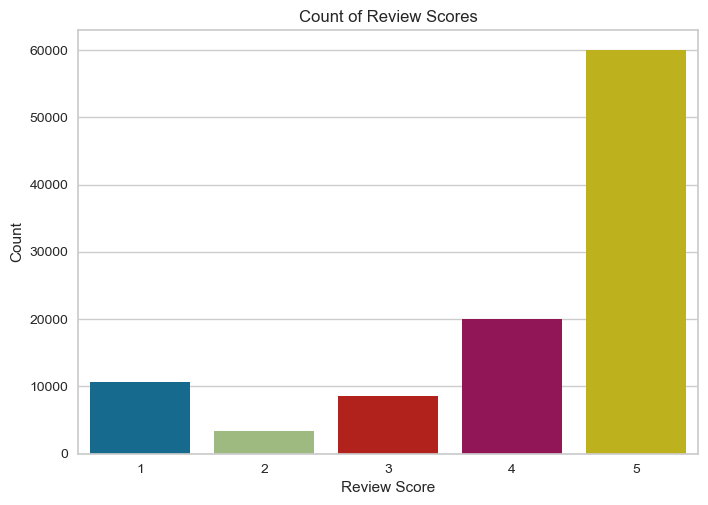

In [24]:
# Create a countplot of review scores
sns.countplot(x=merged_data['review_score'])
plt.xlabel('Review Score')
plt.ylabel('Count')
plt.title('Count of Review Scores')
plt.show()

### Plot of Review Scores by Product Category

<Figure size 2500x1000 with 0 Axes>

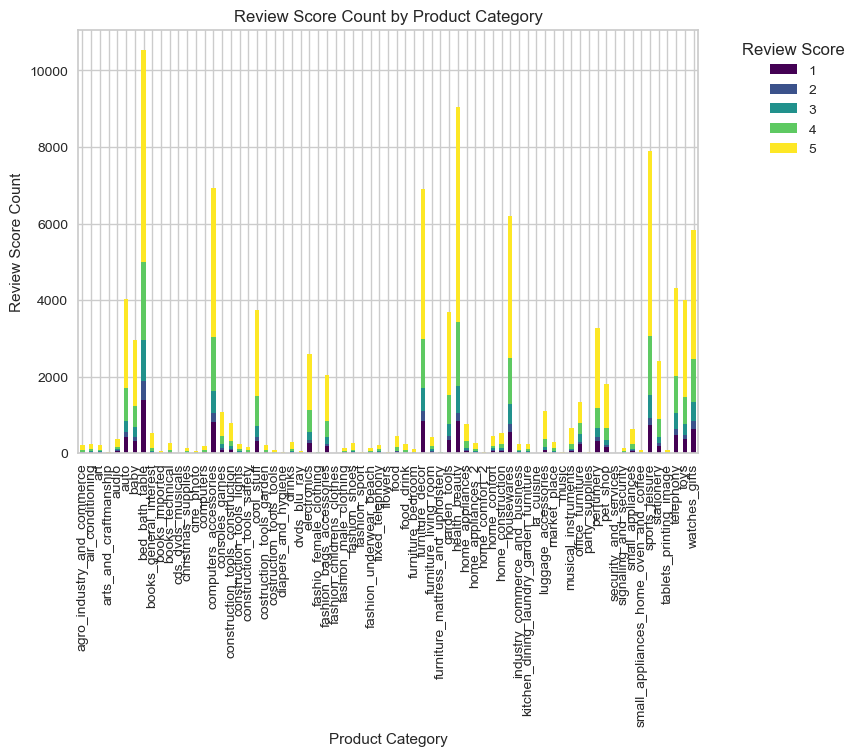

In [25]:
# Filter the dataset for relevant columns
review_data = merged_data[['product_category_name_english', 'review_score']]

# Group the data by 'product_category_name_english' and count the occurrences of each review score
review_score_count = review_data.groupby(['product_category_name_english', 'review_score']).size().unstack(fill_value=0)


# Create a stacked bar plot to visualize the count of review scores for each product category
plt.figure(figsize=(25, 10))
review_score_count.plot(kind='bar', stacked=True, colormap='viridis')
plt.xlabel('Product Category')
plt.ylabel('Review Score Count')
plt.title('Review Score Count by Product Category')
plt.legend(title='Review Score', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

### Plot of Review Scores by Customer State

<Figure size 2500x1000 with 0 Axes>

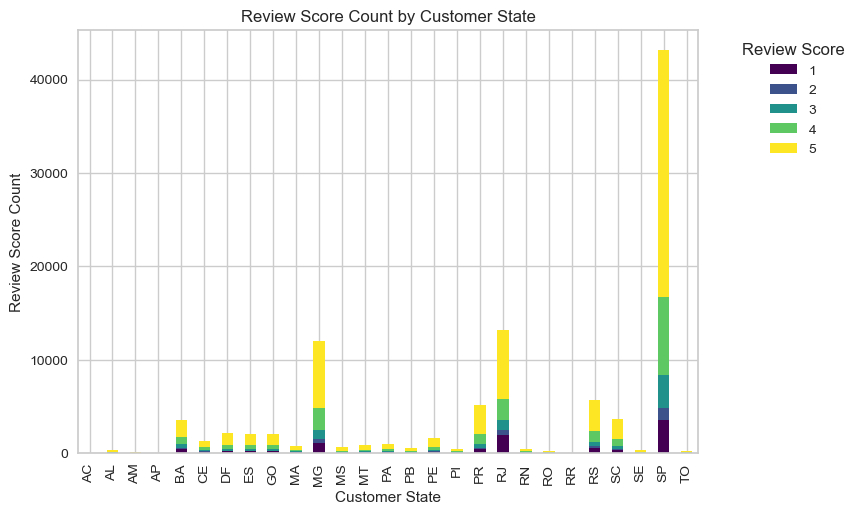

In [26]:
# Filter the dataset for relevant columns
review_data = merged_data[['customer_state', 'review_score']]

# Group the data by 'customer_state' and count the occurrences of each review score
review_score_count = review_data.groupby(['customer_state', 'review_score']).size().unstack(fill_value=0)

# Create a stacked bar plot to visualize the count of review scores for each customer state
plt.figure(figsize=(25, 10))
review_score_count.plot(kind='bar', stacked=True, colormap='viridis')
plt.xlabel('Customer State')
plt.ylabel('Review Score Count')
plt.title('Review Score Count by Customer State')
plt.legend(title='Review Score', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

### Plot for Review Scores for each Product Category in each Customer State

<Figure size 5500x1000 with 0 Axes>

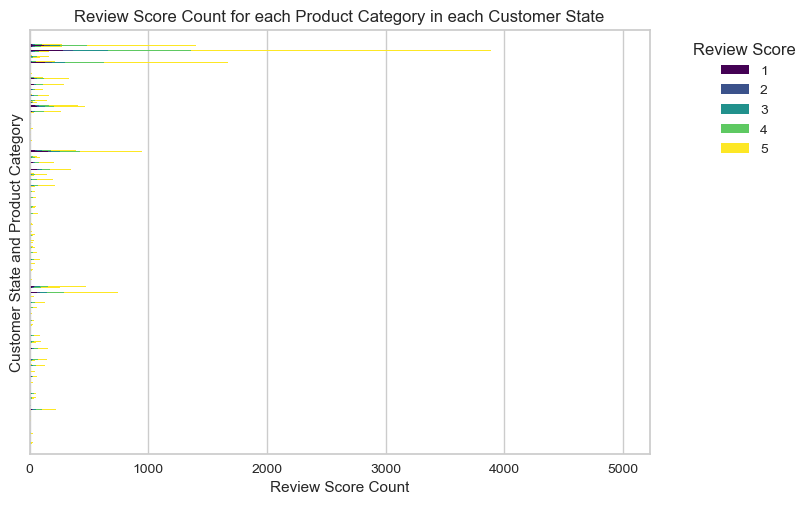

In [27]:
# Filter the dataset for relevant columns
review_data = merged_data[['customer_state', 'product_category_name_english', 'review_score']]

# Group the data by 'customer_state', 'product_category_name_english' and count the occurrences of each review score
review_score_count = review_data.groupby(['customer_state', 'product_category_name_english', 'review_score']).size().unstack(fill_value=0)

# Create a stacked horizontal bar plot to visualize the count of review scores for each product category in each customer state
plt.figure(figsize=(55, 10))
ax=review_score_count.plot(kind='barh', stacked=True, colormap='viridis')
ax.set_yticks([])  # Remove y-axis ticks (index names)
plt.ylabel('Customer State and Product Category')
plt.xlabel('Review Score Count')
plt.title('Review Score Count for each Product Category in each Customer State')
plt.legend(title='Review Score', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

## Payment Type Plot

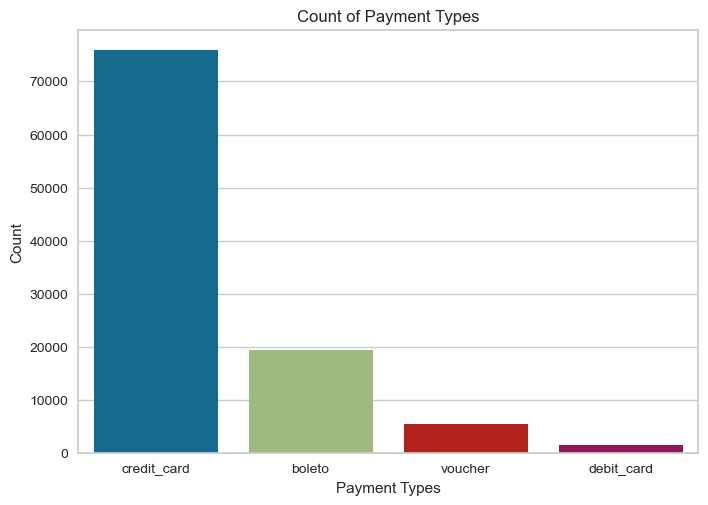

In [28]:
# Create a countplot of payment type
sns.countplot(x=merged_data['payment_type'])
plt.xlabel('Payment Types')
plt.ylabel('Count')
plt.title('Count of Payment Types')
plt.show()

## Product Sales Data Analysis

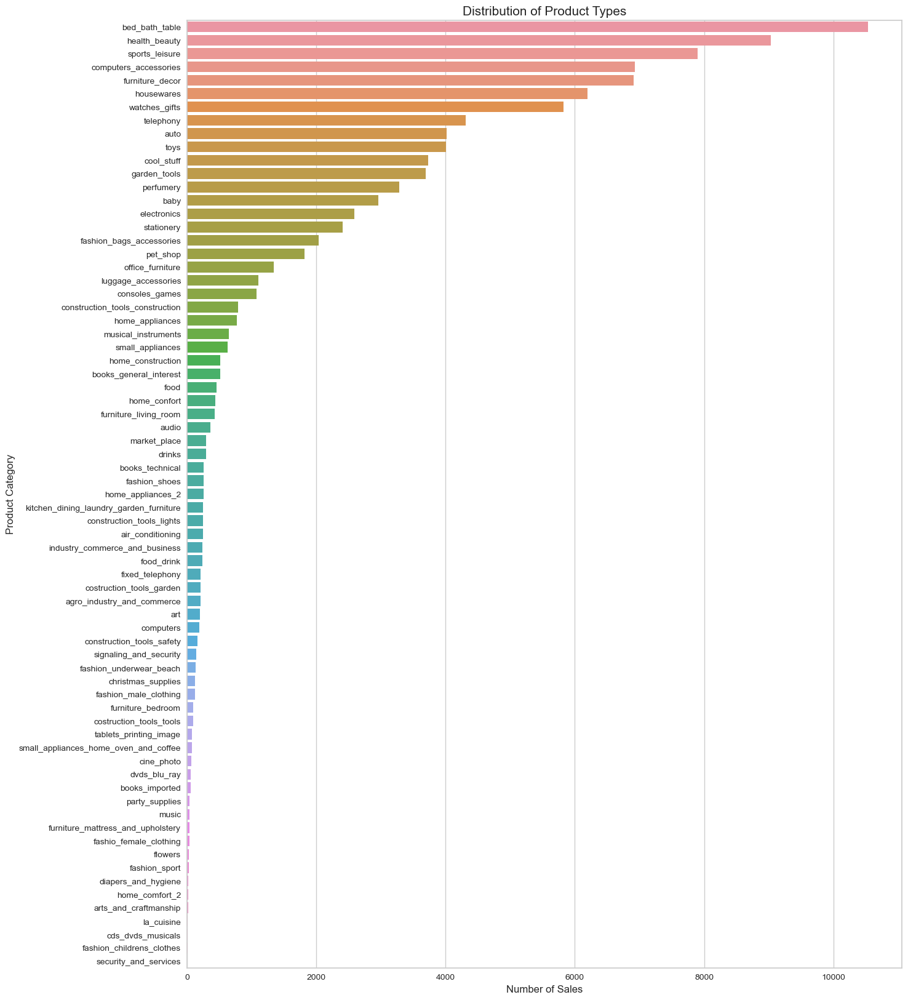

In [29]:
# Create a barplot of product categories by counts
category_counts = merged_data['product_category_name_english'].value_counts()

plt.figure(figsize=(15,20))
sns.barplot(y=category_counts.index, x=category_counts.values)
plt.xlabel('Number of Sales', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.title('Distribution of Product Types', fontsize=15)
plt.show()

## Revenue Data Analysis by Product Category

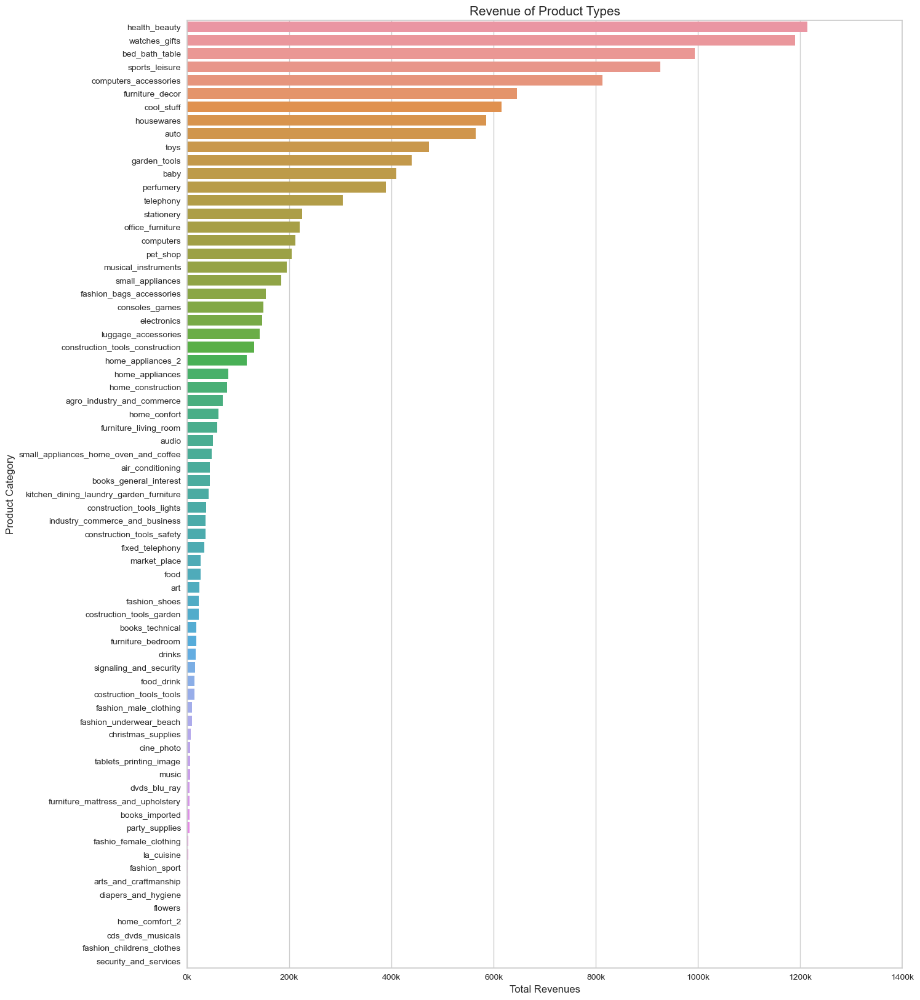

In [30]:
# Group by product category and sum the prices
revenue_by_category = merged_data.groupby("product_category_name_english")["price"].sum().sort_values(ascending=False)

# Create a barplot of total revenue by product category
plt.figure(figsize=(15,20))
sns.barplot(y=revenue_by_category.index, x=revenue_by_category.values)
plt.xlabel('Total Revenues', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.title('Revenue of Product Types', fontsize=15)

# Adjust x-tick labels
ticks = plt.xticks()[0]
labels = [f"{int(tick/1000)}k" for tick in ticks]
plt.xticks(ticks, labels)
plt.show()

## Revenue Data Analysis by Customer State

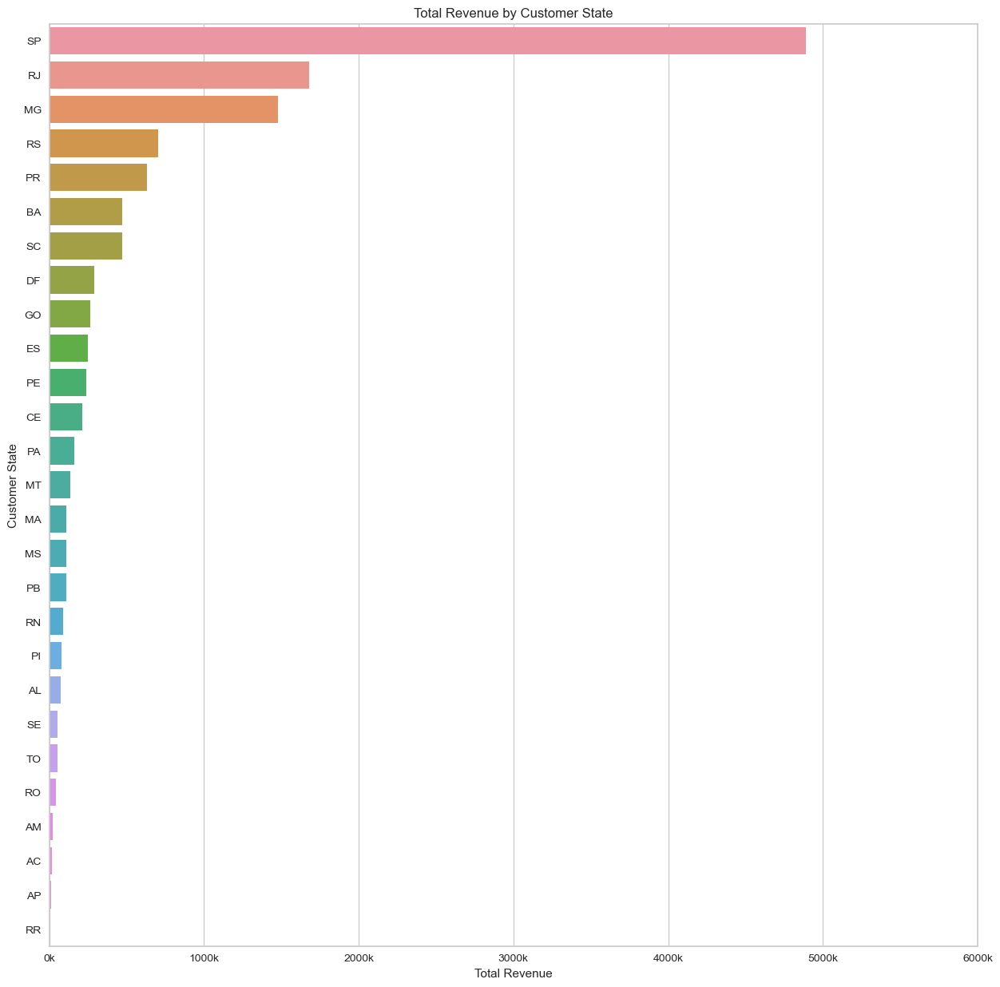

In [31]:
# Group by customer state and sum the prices
revenue_by_state = merged_data.groupby('customer_state')['price'].sum().sort_values(ascending=False)

# Create a barplot of total revenue by customer state
plt.figure(figsize=(15,15))
sns.barplot(y=revenue_by_state.index, x=revenue_by_state.values)
plt.ylabel('Customer State')
plt.xlabel('Total Revenue')
plt.title('Total Revenue by Customer State')

# Adjust x-tick labels
ticks = plt.xticks()[0]
labels = [f"{int(tick/1000)}k" for tick in ticks]
plt.xticks(ticks, labels)
plt.show()
plt.show()

## Total Revenue

In [32]:
# Calculate the total revenue
total_revenue = merged_data['price'].sum()

# Print the results
print(f"Total Revenue: {total_revenue:,.2f}")

Total Revenue: 12,675,772.77


## Average Delivery Time wrt Customer's State

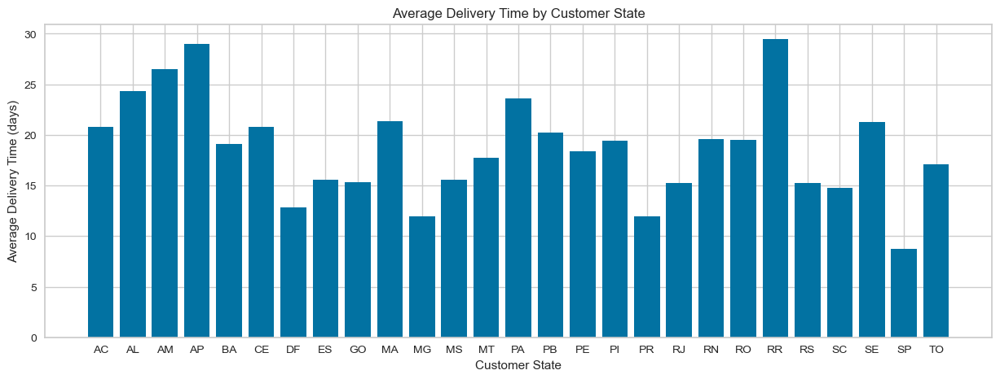

In [33]:
# Calculate the difference between the order_delivered_customer_date and order_purchase_timestamp columns
merged_data['delivery_time'] = (merged_data['order_delivered_customer_date'] - merged_data['order_purchase_timestamp']) / pd.Timedelta(days=1)

# Calculate the average delivery time by customer state
delivery_time_data = merged_data.groupby('customer_state')['delivery_time'].mean().reset_index()

# Create a bar plot of average delivery time by customer state
plt.figure(figsize=(15,5))
plt.bar(delivery_time_data['customer_state'], delivery_time_data['delivery_time'])
plt.xlabel('Customer State')
plt.ylabel('Average Delivery Time (days)')
plt.title('Average Delivery Time by Customer State')
plt.show()

## Monthly Sales Quantity and Revenue Analysis

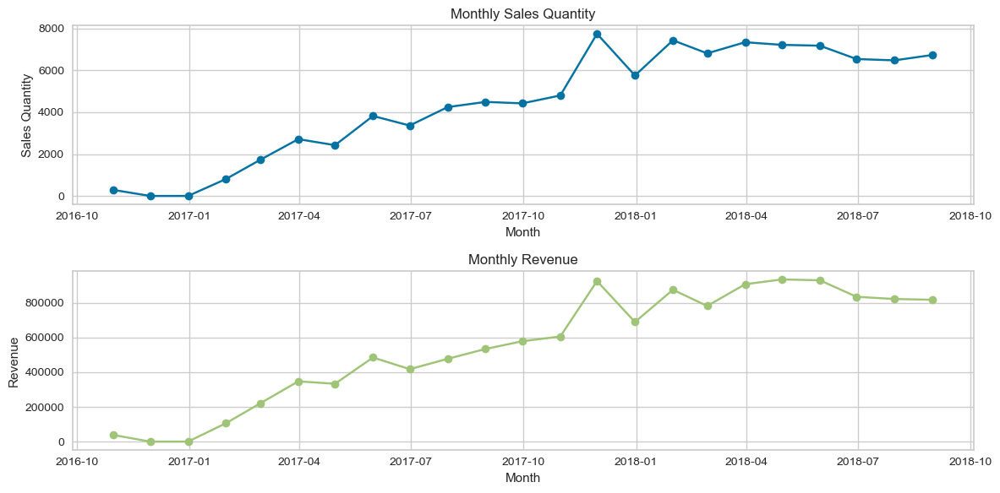

In [34]:
# Filter for 'delivered' orders to calculate sales quantity
delivered_orders = merged_data[merged_data['order_status'] == 'delivered']

# Calculate sales quantity by counting the number of delivered orders
sales_quantity = delivered_orders.groupby(pd.Grouper(key='order_purchase_timestamp', freq='M'))['order_status'].count()

# Calculate revenue by summing the 'price' column for each order
revenue = delivered_orders.groupby(pd.Grouper(key='order_purchase_timestamp', freq='M'))['price'].sum()

# Create a new DataFrame with sales quantity and revenue
monthly_data = pd.DataFrame({'Sales Quantity': sales_quantity, 'Revenue': revenue})

# Plotting the data
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(monthly_data.index, monthly_data['Sales Quantity'], marker='o', color='b')
plt.xlabel('Month')
plt.ylabel('Sales Quantity')
plt.title('Monthly Sales Quantity')

plt.subplot(2, 1, 2)
plt.plot(monthly_data.index, monthly_data['Revenue'], marker='o', color='g')
plt.xlabel('Month')
plt.ylabel('Revenue')
plt.title('Monthly Revenue')

plt.tight_layout()
plt.show()

## Annually Sales Quantity and Revenue Analysis

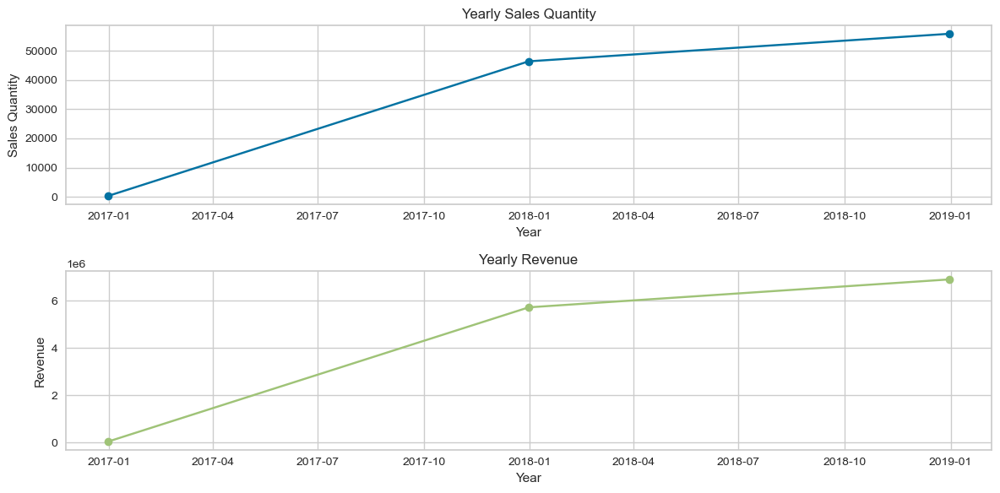

In [35]:
# Filter for 'delivered' orders to calculate sales quantity
delivered_orders = merged_data[merged_data['order_status'] == 'delivered']

# Calculate sales quantity by counting the number of delivered orders
sales_quantity = delivered_orders.groupby(pd.Grouper(key='order_purchase_timestamp', freq='A'))['order_status'].count()

# Calculate revenue by summing the 'price' column for each order
revenue = delivered_orders.groupby(pd.Grouper(key='order_purchase_timestamp', freq='A'))['price'].sum()

# Create a new DataFrame with sales quantity and revenue
yearly_data = pd.DataFrame({'Sales Quantity': sales_quantity, 'Revenue': revenue})

# Plotting the data
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(yearly_data.index, yearly_data['Sales Quantity'], marker='o', color='b')
plt.xlabel('Year')
plt.ylabel('Sales Quantity')
plt.title('Yearly Sales Quantity')

plt.subplot(2, 1, 2)
plt.plot(yearly_data.index, yearly_data['Revenue'], marker='o', color='g')
plt.xlabel('Year')
plt.ylabel('Revenue')
plt.title('Yearly Revenue')

plt.tight_layout()
plt.show()

## Periodically Sales Quantity and Revenue Analysis

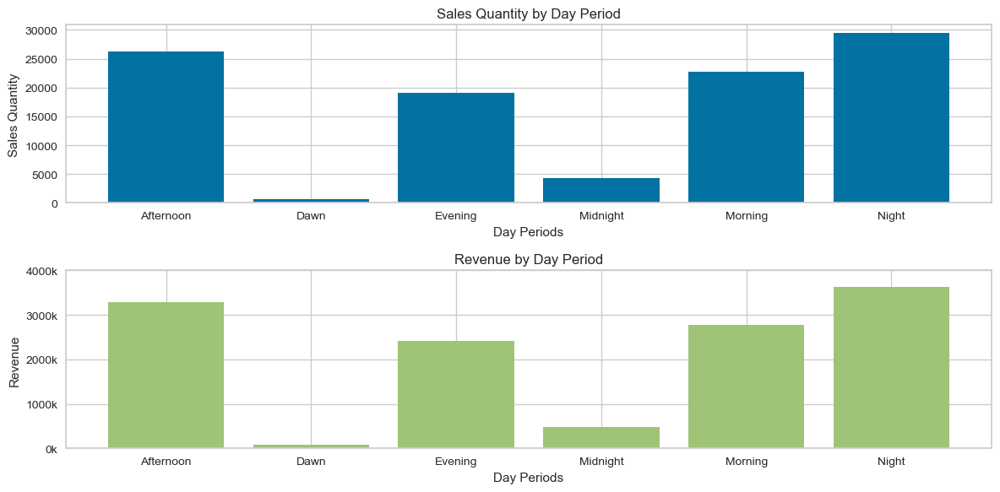

In [36]:
# Create a new column to categorize the 'order_purchase_timestamp' into different day periods
merged_data['day_period'] = merged_data['order_purchase_timestamp'].apply (lambda x: 'Midnight' if (0 <= x.hour < 3) else ('Dawn' if (3 <= x.hour < 6) else ('Morning' if (6 <= x.hour < 12) else ('Afternoon' if (12 <= x.hour < 16) else ('Evening' if (16 <= x.hour < 19) else 'Night')))))

# Filter for 'delivered' orders to calculate sales quantity
delivered_orders = merged_data[merged_data['order_status'] == 'delivered']

# Calculate sales quantity by counting the number of delivered orders
sales_quantity = delivered_orders.groupby('day_period')['order_status'].count()

# Calculate revenue by summing the 'price' column for each order
revenue = delivered_orders.groupby('day_period')['price'].sum()

# Create a new DataFrame with sales quantity and revenue
day_period_data = pd.DataFrame({'Sales Quantity': sales_quantity, 'Revenue': revenue})

# Plotting the data using matplotlib and seaborn
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.bar(day_period_data.index, day_period_data['Sales Quantity'], color='b')
plt.xlabel('Day Periods')
plt.ylabel('Sales Quantity')
plt.title('Sales Quantity by Day Period')

plt.subplot(2, 1, 2)
plt.bar(day_period_data.index, day_period_data['Revenue'], color='g')
plt.xlabel('Day Periods')
plt.ylabel('Revenue')
plt.title('Revenue by Day Period')

# Adjust y-tick labels
ticks = plt.yticks()[0]
labels = [f"{int(tick/1000)}k" for tick in ticks]
plt.yticks(ticks, labels)

plt.tight_layout()
plt.show()

## OLAP Operations Analysis

Slicing: Slicing in Online Analytical Processing (OLAP) involves selecting one specific dimension from a cube to create a new sub-cube, offering information from a different perspective. It focuses on a particular dimension and filters the data based on specific criteria, resulting in a subset of the original cube.

Dicing: Dicing, similar to slicing, defines a subcube by selecting two or more dimensions from a cube. It involves creating a new sub-cube by adding values for each selected dimension, allowing for a more detailed analysis of the data based on multiple criteria.

Roll-up: Roll-up, also known as consolidation or aggregation, is an OLAP operation that involves summarizing data by climbing up a concept hierarchy for a dimension or reducing dimensions. It aggregates data at a higher level of abstraction, allowing for a more generalized view of the information.

Drill-down: Drill-down is the reverse operation of roll-up in OLAP. It involves navigating from less detailed data to highly detailed data by stepping down a concept hierarchy for a dimension or introducing a new dimension. Drill-down adds more granularity to the data, providing a more detailed perspective.

Pivot: Pivot, also known as rotation, is an OLAP operation that reorients the data axes to present an alternative view of the data cube. It involves changing the dimensional orientation of the cube, allowing for a different perspective on the data by grouping data with different dimensions.

In [37]:
merged_data.describe().T

,count,mean,std,min,25%,50%,75%,max
price,102430.0,123.750588,186.630031,0.850000,40.500000,78.000000,139.000000,6735.000000
payment_sequential,102430.0,1.090159,0.669913,1.000000,1.000000,1.000000,1.000000,26.000000
payment_installments,102430.0,2.896144,2.725139,0.000000,1.000000,1.000000,4.000000,24.000000
payment_value,102430.0,156.468263,215.399544,0.000000,57.720000,102.030000,175.917500,13664.080000
review_score,102430.0,4.125491,1.309831,1.000000,4.000000,5.000000,5.000000,5.000000
product_photos_qty,102430.0,2.240047,1.742012,1.000000,1.000000,2.000000,3.000000,20.000000
product_weight_g,102430.0,2104.744899,3765.523013,0.000000,300.000000,700.000000,1800.000000,40425.000000
product_length_cm,102430.0,30.209880,16.102063,7.000000,18.000000,25.000000,38.000000,105.000000
product_height_cm,102430.0,16.428019,13.310233,2.000000,8.000000,13.000000,20.000000,105.000000
product_width_cm,102430.0,23.135126,11.770592,6.000000,15.000000,20.000000,30.000000,118.000000


In [38]:
merged_data.describe(include='object').T

,count,unique,top,freq
customer_unique_id,102430,91465,9a736b248f67d166d2fbb006bcb877c3,54
customer_city,102430,4071,sao paulo,16039
customer_state,102430,27,SP,43142
order_status,102430,2,delivered,102423
payment_type,102430,4,credit_card,75903
seller_city,102430,587,sao paulo,25353
seller_state,102430,22,SP,72787
product_category_name_english,102430,71,bed_bath_table,10536
day_period,102430,6,Night,29402


### Slicing

In [39]:
sliced_data1 = merged_data[merged_data['order_status'] == 'delivered']
sliced_data1

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05,2017-05-22 15:22:12,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,8.812500,Afternoon
1,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19,2017-11-23 00:47:18,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.971956,Midnight
3,3c799d181c34d51f6d44bbbc563024db,nova santa rita,RS,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12,2017-05-22 22:22:56,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.571273,Night
4,23397e992b09769faf5e66f9e171a241,mage,RJ,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22,2018-02-18 21:29:19,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,25.057870,Night
5,567ab47ca4deb92d46dbf54dce07d0a7,angelina,SC,delivered,2017-03-23 15:10:17,2017-03-23 15:25:11,2017-03-28 18:23:51,2017-04-11 10:16:56,2017-04-24,2017-04-05 15:25:11,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.796285,Afternoon
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115604,96328ac15f58fbb232fe14b182103382,vargem bonita,SC,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,2018-04-06 22:05:04,2018-04-18,2018-04-05 19:55:18,...,2.0,12500.0,83.0,21.0,43.0,concordia,SC,la_cuisine,6.116215,Night
115605,bf5ed75fca98e8f79c49e9a5bf7690e1,limeira,SP,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,2017-04-18 09:53:40,2017-05-04,2017-04-17 03:45:26,...,1.0,450.0,31.0,10.0,18.0,concordia,SC,la_cuisine,8.575729,Night
115606,a490d5875edefe9bb8f5101ec2f6b56f,sao joao da boa vista,SP,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,2017-09-05 21:42:35,2017-09-19,2017-09-01 10:05:04,...,1.0,2200.0,84.0,12.0,15.0,concordia,SC,la_cuisine,8.496227,Morning
115607,6968d41eb700f1ea39424e04b854bf7e,belo horizonte,MG,delivered,2017-07-31 18:10:29,2017-07-31 18:25:20,2017-08-02 18:22:30,2017-08-09 20:38:07,2017-08-28,2017-08-04 18:25:20,...,1.0,2700.0,85.0,7.0,40.0,concordia,SC,la_cuisine,9.102523,Evening


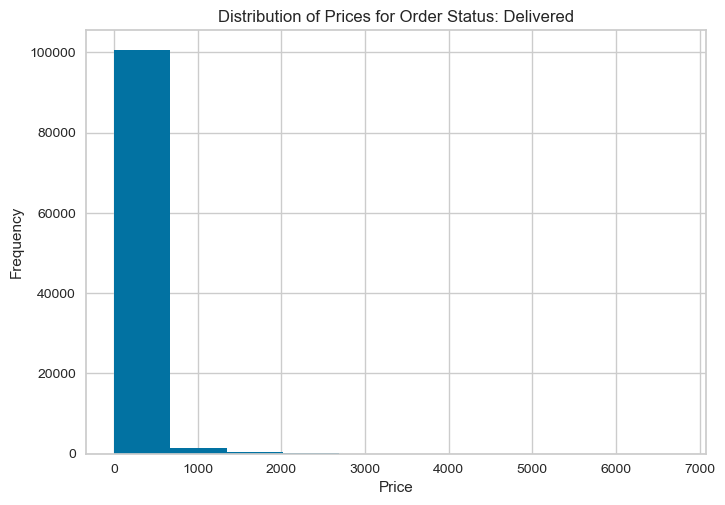

In [40]:
sliced_data1['price'].plot(kind='hist', title='Distribution of Prices for Order Status: Delivered')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In [41]:
sliced_data2 = merged_data[merged_data['payment_type'] == 'credit_card']
sliced_data2

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05,2017-05-22 15:22:12,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,8.812500,Afternoon
1,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19,2017-11-23 00:47:18,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.971956,Midnight
3,3c799d181c34d51f6d44bbbc563024db,nova santa rita,RS,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12,2017-05-22 22:22:56,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.571273,Night
4,23397e992b09769faf5e66f9e171a241,mage,RJ,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22,2018-02-18 21:29:19,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,25.057870,Night
5,567ab47ca4deb92d46dbf54dce07d0a7,angelina,SC,delivered,2017-03-23 15:10:17,2017-03-23 15:25:11,2017-03-28 18:23:51,2017-04-11 10:16:56,2017-04-24,2017-04-05 15:25:11,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.796285,Afternoon
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115602,578035514ad8238fa724f24b4aabc1df,tubarao,SC,delivered,2017-07-22 17:55:13,2017-07-22 18:10:09,2017-07-24 18:28:01,2017-07-27 19:03:29,2017-08-11,2017-07-27 18:10:09,...,1.0,1750.0,95.0,9.0,37.0,concordia,SC,la_cuisine,5.047407,Evening
115603,a0abd26659c9914690cbd3320d39fd96,canoas,RS,delivered,2017-05-27 14:03:20,2017-05-27 14:15:16,2017-05-29 09:30:43,2017-06-03 09:20:19,2017-06-21,2017-06-01 14:15:16,...,1.0,8800.0,55.0,15.0,55.0,concordia,SC,la_cuisine,6.803461,Afternoon
115604,96328ac15f58fbb232fe14b182103382,vargem bonita,SC,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,2018-04-06 22:05:04,2018-04-18,2018-04-05 19:55:18,...,2.0,12500.0,83.0,21.0,43.0,concordia,SC,la_cuisine,6.116215,Night
115606,a490d5875edefe9bb8f5101ec2f6b56f,sao joao da boa vista,SP,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,2017-09-05 21:42:35,2017-09-19,2017-09-01 10:05:04,...,1.0,2200.0,84.0,12.0,15.0,concordia,SC,la_cuisine,8.496227,Morning


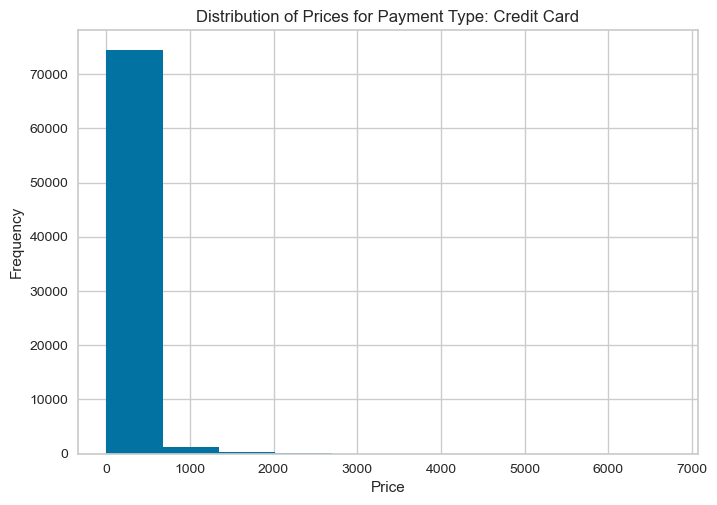

In [42]:
sliced_data2['price'].plot(kind='hist', title='Distribution of Prices for Payment Type: Credit Card')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In [43]:
sliced_data3 = merged_data[merged_data['product_category_name_english'] == 'bed_bath_table']
sliced_data3

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
35618,a5844ba4bfc8d0cc61d13027c7e63bcc,sao paulo,SP,delivered,2018-05-16 13:04:22,2018-05-16 13:19:29,2018-05-17 15:06:00,2018-05-24 15:16:41,2018-06-05,2018-05-22 13:19:29,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,8.091887,Afternoon
35619,ac61539bd1e37ef9fc8b951720d90bdb,avare,SP,delivered,2018-02-16 07:59:09,2018-02-17 03:47:44,2018-02-20 17:17:11,2018-02-28 11:33:28,2018-03-08,2018-02-22 02:47:44,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,12.148831,Morning
35620,ce5c267bd53f4e6683c66f7cb5c5c067,rio de janeiro,RJ,delivered,2018-01-13 23:21:55,2018-01-14 23:12:20,2018-01-15 22:43:08,2018-02-02 16:58:56,2018-02-14,2018-01-18 23:12:20,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,19.734039,Night
35621,e67af1efd445becc5019902668fe3218,andradina,SP,delivered,2017-06-19 20:32:27,2017-06-20 11:05:29,2017-06-21 09:58:41,2017-06-28 15:32:55,2017-07-07,2017-06-26 11:05:29,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,8.791991,Night
35622,d0972d0443d22c762575dcfbc3eb8b0a,jundiai,SP,delivered,2017-05-31 21:47:11,2017-06-02 04:15:19,2017-06-02 15:30:15,2017-06-08 12:15:22,2017-06-21,2017-06-08 04:15:19,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,7.602905,Night
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47459,87a6af9cd74c6568bc6b6900d25460df,belo horizonte,MG,delivered,2018-06-02 13:29:22,2018-06-02 13:50:03,2018-06-07 11:23:00,2018-06-13 16:28:44,2018-07-17,2018-06-11 13:50:03,...,2.0,200.0,49.0,10.0,40.0,porto alegre,RS,bed_bath_table,11.124560,Afternoon
47460,24ffbb655914998319377df431e3c47a,pariquera-acu,SP,delivered,2018-08-21 10:38:28,2018-08-21 10:51:04,2018-08-21 13:30:00,2018-08-24 21:08:45,2018-09-06,2018-08-27 10:51:04,...,3.0,450.0,27.0,6.0,22.0,santo andre,SP,bed_bath_table,3.437697,Morning
47461,89ac3e5e9a034510b8cc15f21bf1c8cf,sao paulo,SP,delivered,2018-08-18 15:57:06,2018-08-18 16:10:10,2018-08-20 13:53:00,2018-08-21 19:38:36,2018-08-24,2018-08-23 16:10:10,...,3.0,600.0,28.0,6.0,23.0,santo andre,SP,bed_bath_table,3.153819,Afternoon
47462,886583680443fec2ba8b1426cc6facde,jundiai,SP,delivered,2018-08-05 14:55:14,2018-08-05 15:10:23,2018-08-14 11:46:00,2018-08-20 15:48:37,2018-08-20,2018-08-09 15:10:23,...,2.0,7600.0,50.0,15.0,55.0,ivoti,RS,bed_bath_table,15.037072,Afternoon


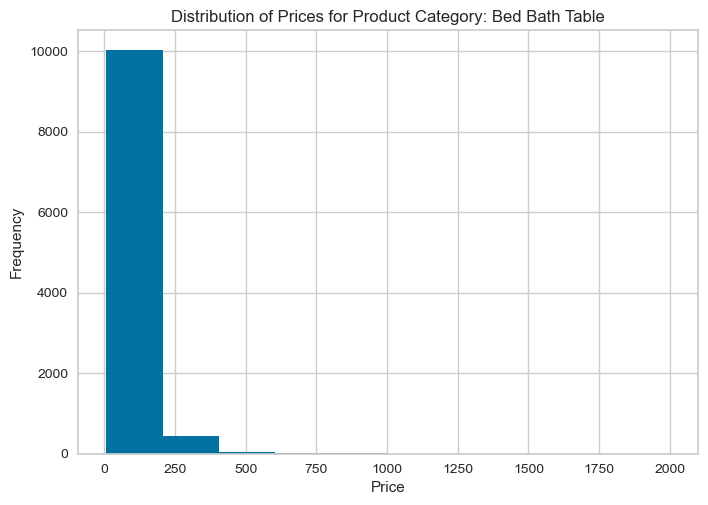

In [44]:
sliced_data3['price'].plot(kind='hist', title='Distribution of Prices for Product Category: Bed Bath Table')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

### Dicing

In [45]:
diced_data1 = merged_data[(merged_data['customer_state'] == 'SP') & (merged_data['order_status'] == 'delivered')]
diced_data1

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05,2017-05-22 15:22:12,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,8.812500,Afternoon
22,b428f59c73c1bbeb3584744b4570654b,sao paulo,SP,delivered,2017-06-24 08:59:47,2017-06-27 03:45:30,2017-06-29 17:37:56,2017-07-03 14:27:59,2017-07-17,2017-07-11 03:45:30,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,9.227917,Morning
33,7fcf7dc77013a88b9eef97c288b3eb8d,praia grande,SP,delivered,2017-06-02 11:06:09,2017-06-02 11:23:00,2017-06-08 14:58:56,2017-06-14 15:35:06,2017-06-22,2017-06-14 11:23:00,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,12.186771,Morning
36,52d8a619dff23c2985434b25e9862ff8,botucatu,SP,delivered,2017-04-24 12:16:12,2017-04-25 06:35:40,2017-05-15 15:45:56,2017-05-22 17:36:55,2017-05-19,2017-05-10 06:35:40,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,28.222720,Afternoon
39,661ada8f1f0f348790c6b9ce57d51f55,marilia,SP,delivered,2018-04-03 21:24:29,2018-04-03 21:35:21,2018-04-17 22:38:18,2018-04-24 21:14:41,2018-04-27,2018-04-17 21:35:21,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,20.993194,Night
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115597,6c861f46d09c560422f6ba6b33c017fe,maua,SP,delivered,2017-08-12 19:20:39,2017-08-12 19:30:17,2017-08-14 18:26:28,2017-08-17 18:28:10,2017-09-05,2017-08-17 19:30:17,...,1.0,7600.0,55.0,15.0,55.0,concordia,SC,la_cuisine,4.963553,Night
115599,923bbadc05e0de833a6ea5e3d546c4d0,sao paulo,SP,delivered,2018-04-17 21:01:58,2018-04-17 21:15:10,2018-04-18 18:52:45,2018-04-23 18:01:57,2018-05-09,2018-04-23 21:15:10,...,1.0,2450.0,81.0,7.0,40.0,concordia,SC,la_cuisine,5.874988,Night
115601,9b8844d7cceb1277e6508cce966e4a09,taboao da serra,SP,delivered,2018-01-01 17:03:13,2018-01-01 17:11:48,2018-01-02 15:58:13,2018-01-10 13:45:30,2018-01-30,2018-01-05 17:11:18,...,1.0,1750.0,95.0,9.0,37.0,concordia,SC,la_cuisine,8.862697,Evening
115605,bf5ed75fca98e8f79c49e9a5bf7690e1,limeira,SP,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,2017-04-18 09:53:40,2017-05-04,2017-04-17 03:45:26,...,1.0,450.0,31.0,10.0,18.0,concordia,SC,la_cuisine,8.575729,Night


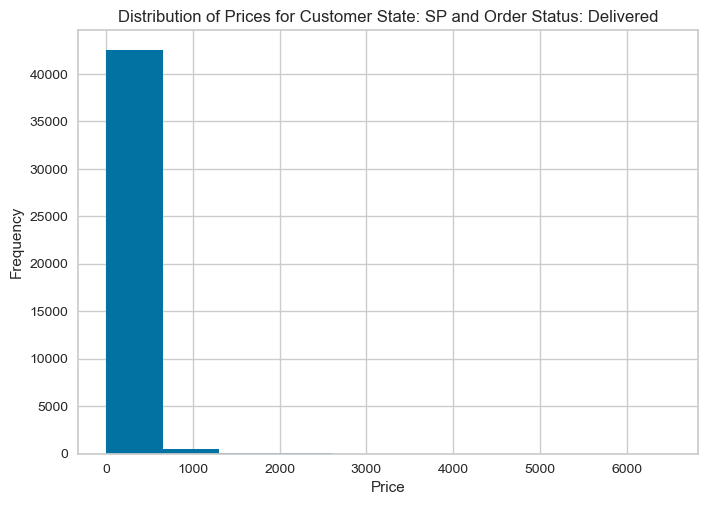

In [46]:
diced_data1['price'].plot(kind='hist', title='Distribution of Prices for Customer State: SP and Order Status: Delivered')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In [47]:
diced_data2 = merged_data[(merged_data['customer_city'] == 'sao paulo') & (merged_data['payment_type'] == 'credit_card')]
diced_data2

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
44,c666e59a2d3ced923880461526113d38,sao paulo,SP,delivered,2018-02-24 08:45:01,2018-02-24 09:47:40,2018-03-01 21:38:37,2018-03-02 21:51:59,2018-03-27,2018-03-09 09:47:40,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,6.546505,Morning
61,060e732b5b29e8181a18229c7b0b2b5e,sao paulo,SP,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13,2018-06-05 16:19:10,...,1.0,8267.0,52.0,52.0,17.0,itaquaquecetuba,SP,office_furniture,26.077153,Evening
70,71c98a01b26884386e5c68ac5b09054a,sao paulo,SP,delivered,2018-07-10 09:13:20,2018-07-11 14:50:15,2018-07-26 15:11:00,2018-08-13 14:32:00,2018-08-03,2018-07-31 14:50:15,...,1.0,12160.0,56.0,51.0,28.0,itaquaquecetuba,SP,office_furniture,34.221296,Morning
116,ad97668eed5826a5d800b15351bea269,sao paulo,SP,delivered,2018-02-28 15:39:15,2018-02-28 15:55:27,2018-03-08 12:56:54,2018-03-09 13:58:31,2018-03-28,2018-03-14 15:55:27,...,1.0,16133.0,63.0,59.0,25.0,itaquaquecetuba,SP,office_furniture,8.930046,Afternoon
122,cfcdff180fb001b7c81c50010eaee53c,sao paulo,SP,delivered,2018-03-15 12:42:15,2018-03-15 12:55:54,2018-03-29 20:51:49,2018-04-02 21:06:12,2018-04-12,2018-03-29 12:55:54,...,1.0,16133.0,63.0,59.0,25.0,itaquaquecetuba,SP,office_furniture,18.349965,Afternoon
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115566,e4469e5047c00b0188885853d357d2ab,sao paulo,SP,delivered,2018-06-03 22:34:58,2018-06-03 22:50:09,2018-06-04 15:15:00,2018-06-05 21:52:02,2018-06-28,2018-06-11 22:50:09,...,3.0,300.0,30.0,20.0,20.0,sao paulo,SP,fashion_childrens_clothes,1.970185,Night
115568,1f83c87997168e248ea52ad3453b069f,sao paulo,SP,delivered,2017-06-08 16:46:33,2017-06-08 18:20:19,2017-06-12 15:31:40,2017-06-13 13:23:01,2017-06-23,2017-06-15 18:20:19,...,5.0,500.0,36.0,10.0,26.0,sao paulo,SP,fashion_childrens_clothes,4.858657,Evening
115574,2c35043ad8f1d00f47150c486b585d8d,sao paulo,SP,delivered,2018-07-24 17:38:40,2018-07-24 17:50:10,2018-07-25 14:35:00,2018-07-26 20:31:50,2018-08-01,2018-07-30 17:50:10,...,7.0,2550.0,46.0,16.0,25.0,osasco,SP,arts_and_craftmanship,2.120255,Evening
115593,0f8dc6a031c49afe5079f92f04c798c3,sao paulo,SP,delivered,2018-07-26 10:29:03,2018-07-26 10:45:15,2018-08-01 14:45:00,2018-08-02 13:21:49,2018-08-07,2018-08-01 10:45:15,...,4.0,2900.0,50.0,10.0,40.0,guarulhos,SP,arts_and_craftmanship,7.119977,Morning


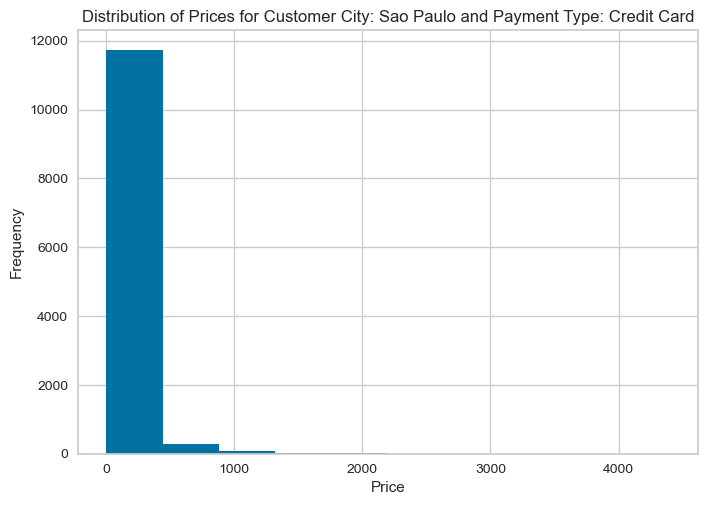

In [48]:
diced_data2['price'].plot(kind='hist', title='Distribution of Prices for Customer City: Sao Paulo and Payment Type: Credit Card')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In [49]:
diced_data3 = merged_data[(merged_data['product_category_name_english'] == 'bed_bath_table') & (merged_data['review_score'] == 5)]
diced_data3

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
35620,ce5c267bd53f4e6683c66f7cb5c5c067,rio de janeiro,RJ,delivered,2018-01-13 23:21:55,2018-01-14 23:12:20,2018-01-15 22:43:08,2018-02-02 16:58:56,2018-02-14,2018-01-18 23:12:20,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,19.734039,Night
35623,12328d63390726821fdcd8e8b77f10b5,coribe,BA,delivered,2017-11-28 09:25:59,2017-11-30 09:18:32,2017-12-04 21:03:27,2017-12-22 01:47:13,2017-12-29,2017-12-06 09:18:32,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,23.681412,Morning
35625,fdb2f8a871f180fefdf3ba06bf7ab179,lagoa vermelha,RS,delivered,2017-06-06 21:31:50,2017-06-06 21:45:13,2017-06-10 09:49:28,2017-06-19 14:41:48,2017-07-03,2017-06-12 21:45:13,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,12.715255,Night
35649,cfdaaa0caea59b06efb4b0fb8c700684,mirante do paranapanema,SP,delivered,2017-03-02 12:56:12,2017-03-02 13:10:31,2017-03-02 15:09:14,2017-03-07 09:54:00,2017-03-21,2017-03-08 13:10:31,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,4.873472,Afternoon
35650,273101692e349c908ab73146dd61798a,rio de janeiro,RJ,delivered,2017-10-10 08:50:08,2017-10-10 09:14:11,2017-10-11 15:47:53,2017-10-25 19:23:44,2017-10-30,2017-10-17 10:14:11,...,1.0,950.0,45.0,15.0,35.0,ibitinga,SP,bed_bath_table,15.440000,Morning
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47451,ef2b78e26635b6c15eee256b4eece7f0,campinas,SP,delivered,2018-03-24 10:34:27,2018-03-24 11:48:18,2018-03-27 00:29:36,2018-03-29 20:27:53,2018-04-30,2018-04-10 11:32:25,...,1.0,1000.0,70.0,10.0,11.0,curitiba,PR,bed_bath_table,5.412106,Morning
47457,fd11aa9da9d882aa6b438b84187fe538,joinville,SC,delivered,2018-06-20 21:24:53,2018-06-20 21:38:33,2018-06-22 15:02:00,2018-06-27 14:26:45,2018-07-23,2018-07-03 21:38:33,...,2.0,3150.0,56.0,12.0,38.0,sao jose dos pinhas,PR,bed_bath_table,6.709630,Night
47458,8dafb82f687e3b0dc9e97b4198b92128,sao borja,RS,delivered,2018-04-13 17:48:03,2018-04-13 18:11:41,2018-04-17 23:42:05,2018-04-25 23:19:46,2018-05-17,2018-04-26 18:11:41,...,2.0,3150.0,56.0,12.0,38.0,sao jose dos pinhas,PR,bed_bath_table,12.230359,Evening
47461,89ac3e5e9a034510b8cc15f21bf1c8cf,sao paulo,SP,delivered,2018-08-18 15:57:06,2018-08-18 16:10:10,2018-08-20 13:53:00,2018-08-21 19:38:36,2018-08-24,2018-08-23 16:10:10,...,3.0,600.0,28.0,6.0,23.0,santo andre,SP,bed_bath_table,3.153819,Afternoon


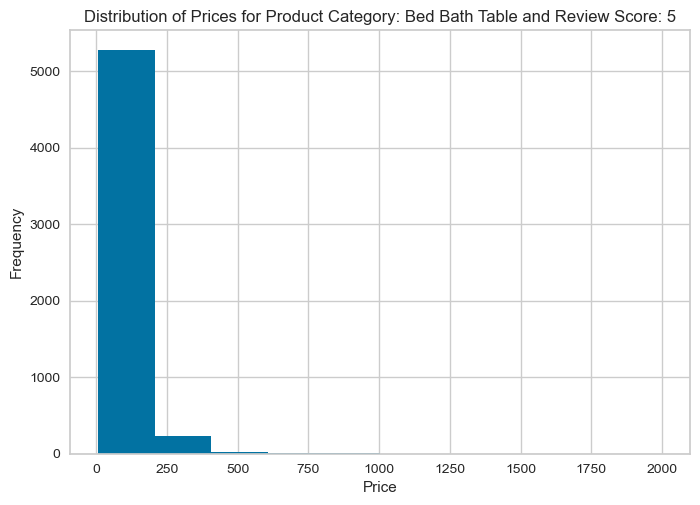

In [50]:
diced_data3['price'].plot(kind='hist', title='Distribution of Prices for Product Category: Bed Bath Table and Review Score: 5')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

### Roll-up

In [51]:
def count_delivered(status_series):
    return (status_series == 'delivered').sum()

rollup_data1 = merged_data.groupby('customer_state').agg({'price': 'sum', 'order_status': count_delivered}) 
rollup_data1

,price,order_status
customer_state,,
AC,16038.47,82
AL,76439.24,413
AM,20997.99,153
AP,12005.88,71
BA,473808.64,3527
CE,215527.98,1363
DF,289631.19,2186
ES,247883.66,2101
GO,266839.73,2082


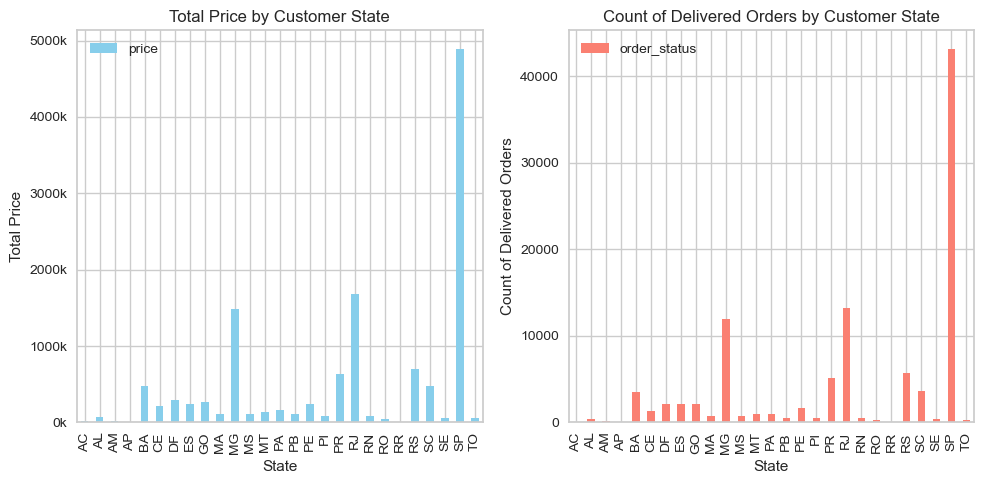

In [52]:
rollup_data1 = merged_data.groupby('customer_state').agg({'price': 'sum', 'order_status': count_delivered}).reset_index()

# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Subplot 1: Customer state versus price
rollup_data1.plot(kind='bar', x='customer_state', y='price', ax=axes[0], color='skyblue')
axes[0].set_title('Total Price by Customer State')
axes[0].set_xlabel('State')
axes[0].set_ylabel('Total Price')

# Adjust y-tick labels for subplot 1
ticks = axes[0].get_yticks()
labels = [f"{int(tick/1000)}k" for tick in ticks]
axes[0].set_yticklabels(labels)

# Subplot 2: Customer state versus order status
rollup_data1.plot(kind='bar', x='customer_state', y='order_status', ax=axes[1], color='salmon')
axes[1].set_title('Count of Delivered Orders by Customer State')
axes[1].set_xlabel('State')
axes[1].set_ylabel('Count of Delivered Orders')

plt.tight_layout()
plt.show()

In [53]:
rollup_data2 = merged_data.groupby('product_category_name_english').agg({'price': 'sum', 'order_status': count_delivered})
rollup_data2

,price,order_status
product_category_name_english,,
agro_industry_and_commerce,69507.79,207
air_conditioning,44818.09,247
art,23850.75,203
arts_and_craftmanship,1814.01,24
audio,51260.16,362
...,...,...
stationery,224886.24,2413
tablets_printing_image,6464.53,81
telephony,304546.46,4311


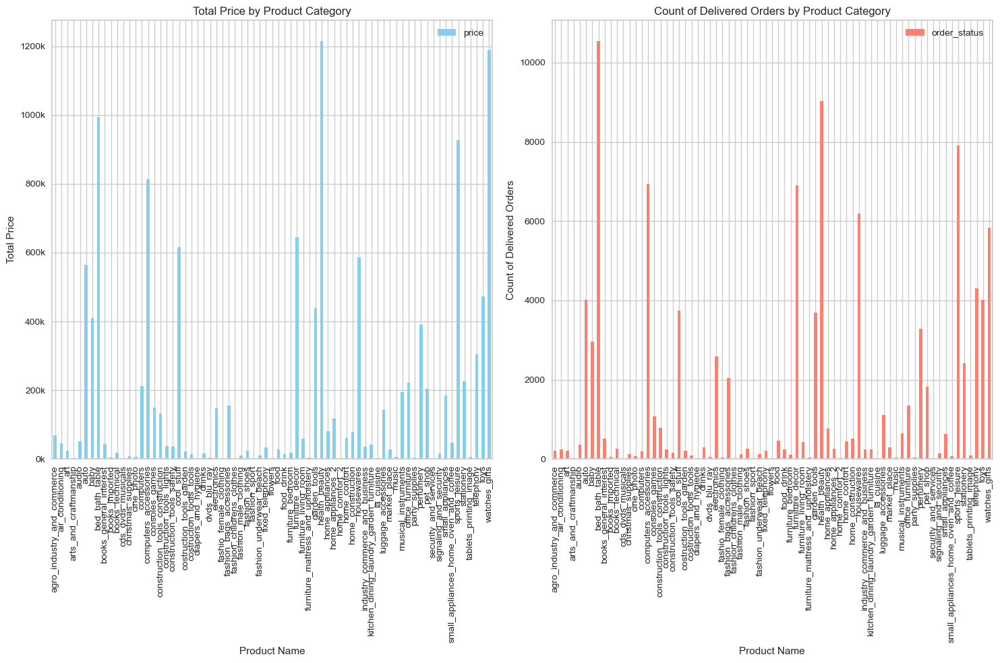

In [54]:
rollup_data2 = merged_data.groupby('product_category_name_english').agg({'price': 'sum', 'order_status': count_delivered}).reset_index()

# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 10))

# Subplot 1: Product category versus price
rollup_data2.plot(kind='bar', x='product_category_name_english', y='price', ax=axes[0], color='skyblue')
axes[0].set_title('Total Price by Product Category')
axes[0].set_xlabel('Product Name')
axes[0].set_ylabel('Total Price')

# Adjust y-tick labels for subplot 1
ticks = axes[0].get_yticks()
labels = [f"{int(tick/1000)}k" for tick in ticks]
axes[0].set_yticklabels(labels)

# Subplot 2: Product category versus order status
rollup_data2.plot(kind='bar', x='product_category_name_english', y='order_status', ax=axes[1], color='salmon')
axes[1].set_title('Count of Delivered Orders by Product Category')
axes[1].set_xlabel('Product Name')
axes[1].set_ylabel('Count of Delivered Orders')

plt.tight_layout()
plt.show()

### Drill-down

In [55]:
drilldown_data1 = merged_data[merged_data['customer_state'] == 'SP'].groupby('product_category_name_english').agg({'price': 'sum', 'order_status': count_delivered})
drilldown_data1

,price,order_status
product_category_name_english,,
agro_industry_and_commerce,29508.26,96
air_conditioning,18158.76,113
art,14718.38,97
arts_and_craftmanship,906.25,16
audio,17637.50,143
...,...,...
stationery,88643.80,1013
tablets_printing_image,2544.86,33
telephony,100082.24,1577


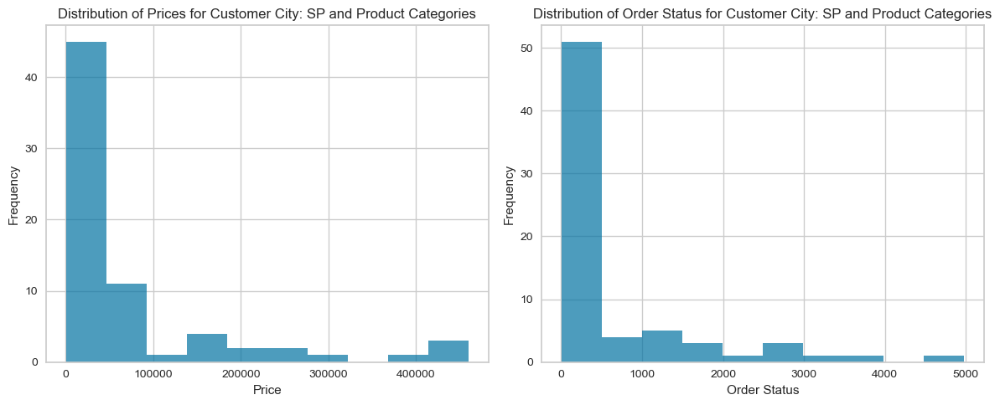

In [56]:
# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Subplot 1: Distribution of prices
drilldown_data1['price'].plot(kind='hist', ax=axes[0], alpha=0.7)
axes[0].set_title('Distribution of Prices for Customer City: SP and Product Categories')
axes[0].set_xlabel('Price')
axes[0].set_ylabel('Frequency')

# Subplot 2: Distribution of order status
drilldown_data1['order_status'].plot(kind='hist', ax=axes[1], alpha=0.7)
axes[1].set_title('Distribution of Order Status for Customer City: SP and Product Categories')
axes[1].set_xlabel('Order Status')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [57]:
drilldown_data2 = merged_data[merged_data['product_category_name_english'] == 'bed_bath_table'].groupby('customer_state').agg({'price': 'sum', 'order_status': count_delivered})
drilldown_data2

,price,order_status
customer_state,,
AC,467.80,3
AL,1913.24,18
AM,743.20,8
AP,489.70,4
BA,23276.71,240
CE,6314.25,78
DF,14852.96,187
ES,22086.03,220
GO,21683.99,222


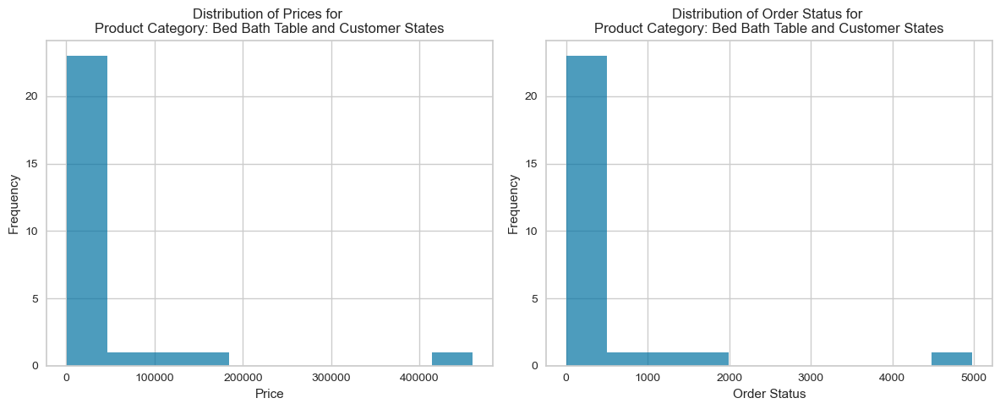

In [58]:
# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Subplot 1: Distribution of prices
drilldown_data2['price'].plot(kind='hist', ax=axes[0], alpha=0.7)
axes[0].set_title('Distribution of Prices for \nProduct Category: Bed Bath Table and Customer States')
axes[0].set_xlabel('Price')
axes[0].set_ylabel('Frequency')

# Subplot 2: Distribution of order status
drilldown_data2['order_status'].plot(kind='hist', ax=axes[1], alpha=0.7)
axes[1].set_title('Distribution of Order Status for \nProduct Category: Bed Bath Table and Customer States')
axes[1].set_xlabel('Order Status')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

### Pivot

In [59]:
pivot_data1 = pd.pivot_table(merged_data, values='price', index='customer_state', columns='product_category_name_english')
pivot_data1

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_state,,,,,,,,,,,,,,,,,,,,,
AC,NaN,NaN,NaN,NaN,NaN,121.394000,232.613333,155.933333,316.900000,NaN,...,NaN,NaN,54.000000,NaN,186.384444,264.450000,NaN,220.792000,78.263333,470.240000
AL,1476.300000,540.000000,NaN,NaN,80.025000,160.887619,104.110000,106.291111,30.500000,NaN,...,NaN,NaN,NaN,NaN,118.836875,74.825556,NaN,159.820741,87.755833,340.971081
AM,NaN,89.000000,58.350000,NaN,89.900000,113.475000,131.538000,92.900000,87.000000,NaN,...,NaN,NaN,NaN,NaN,113.200000,116.498333,50.000000,51.066667,103.080000,187.262222
AP,589.990000,NaN,99.990000,NaN,NaN,405.463333,NaN,122.425000,NaN,NaN,...,NaN,NaN,NaN,NaN,98.255714,117.450000,NaN,76.195000,99.280000,204.975000
BA,453.666667,138.810000,89.895000,NaN,102.192143,191.318926,150.380392,96.986292,61.061538,77.000000,...,NaN,120.973333,205.624211,524.966667,129.849544,96.763333,90.180000,90.922753,123.499187,205.231164
CE,125.966667,223.080000,NaN,NaN,160.315000,233.682182,146.720645,80.951923,234.743750,NaN,...,NaN,NaN,622.327143,NaN,113.235909,83.685758,29.990000,73.109462,124.024516,212.076154
DF,NaN,156.000000,94.298333,129.490000,128.014375,162.931792,129.105758,79.427594,77.611176,NaN,...,100.00,156.507500,645.437391,750.000000,104.745026,97.091087,NaN,63.540000,123.634896,221.738243
ES,221.150000,142.180000,49.900000,NaN,89.395385,163.148452,136.820492,100.391045,152.518750,NaN,...,NaN,127.975000,222.916667,NaN,117.866048,109.769804,45.600000,78.654808,112.516146,184.869444
GO,288.078000,141.981667,103.193333,NaN,282.125714,123.160395,170.270333,97.675631,83.049286,NaN,...,NaN,178.556667,279.442222,NaN,124.977613,97.317872,99.000000,48.084711,97.570465,239.945894


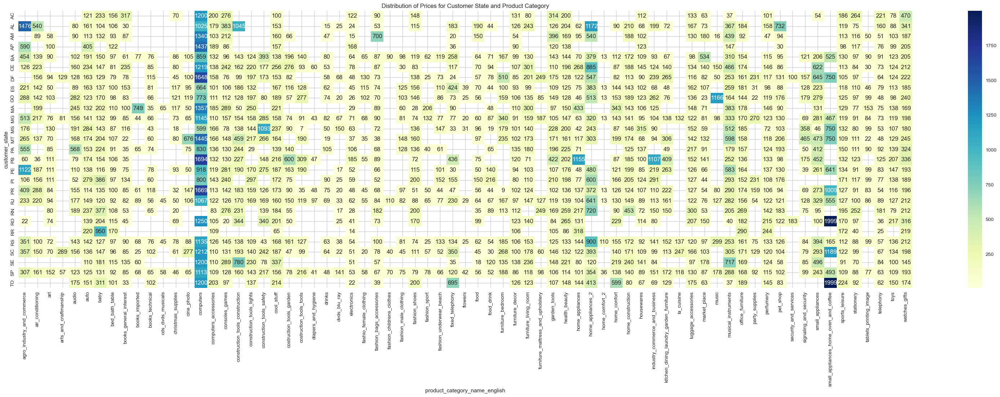

In [60]:
plt.figure(figsize=(40, 10))
sns.heatmap(pivot_data1, cmap='YlGnBu', annot=True, fmt=".0f")
plt.title('Distribution of Prices for Customer State and Product Category')
plt.show()

In [61]:
pivot_data2 = pd.pivot_table(merged_data, values='price', index='order_status', columns='payment_type')
pivot_data2

payment_type,boleto,credit_card,debit_card,voucher
order_status,,,,
canceled,NaN,92.311429,NaN,NaN
delivered,106.112562,129.956200,111.662839,104.108145


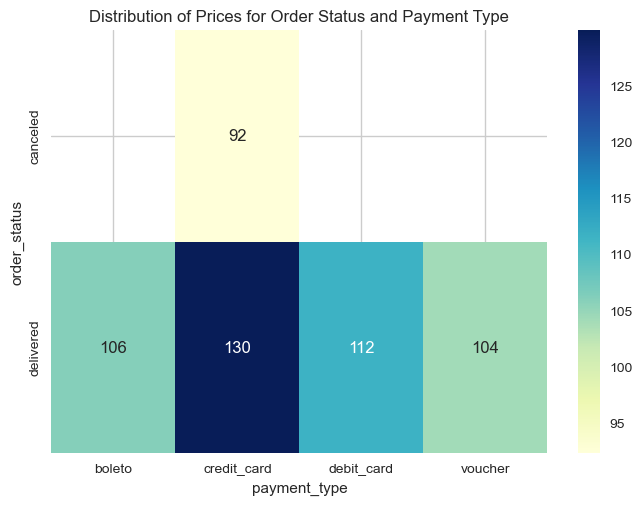

In [62]:
sns.heatmap(pivot_data2, cmap='YlGnBu', annot=True, fmt=".0f")
plt.title('Distribution of Prices for Order Status and Payment Type')
plt.show()

Applying OLAP operations on `customer_unique_id` = '9a736b248f67d166d2fbb006bcb877c3'

In [63]:
merged_data.describe(include='object').T

,count,unique,top,freq
customer_unique_id,102430,91465,9a736b248f67d166d2fbb006bcb877c3,54
customer_city,102430,4071,sao paulo,16039
customer_state,102430,27,SP,43142
order_status,102430,2,delivered,102423
payment_type,102430,4,credit_card,75903
seller_city,102430,587,sao paulo,25353
seller_state,102430,22,SP,72787
product_category_name_english,102430,71,bed_bath_table,10536
day_period,102430,6,Night,29402


In [64]:
# Slicing
slice_data = merged_data[merged_data['customer_unique_id'] == '9a736b248f67d166d2fbb006bcb877c3']
slice_data

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
6774,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6775,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6776,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6777,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6778,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6779,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6780,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6781,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6782,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon
6783,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-07-27 12:50:46,2017-07-27 13:15:19,2017-07-31 20:29:16,2017-08-01 13:42:28,2017-08-16,2017-08-02 13:15:19,...,1.0,15100.0,50.0,40.0,40.0,pedreira,SP,furniture_decor,5.035903,Afternoon


In [65]:
slice_data.describe().T

,count,mean,std,min,25%,50%,75%,max
price,54.0,47.685000,31.545972,12.990000,12.990000,45.200000,83.800000,83.800000
payment_sequential,54.0,10.000000,5.943127,1.000000,5.000000,9.500000,14.750000,21.000000
payment_installments,54.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
payment_value,54.0,7.311296,6.539112,0.240000,2.610000,3.305000,16.700000,16.700000
review_score,54.0,5.000000,0.000000,5.000000,5.000000,5.000000,5.000000,5.000000
product_photos_qty,54.0,4.111111,3.154312,1.000000,2.000000,2.000000,8.000000,8.000000
product_weight_g,54.0,4036.111111,5981.405280,450.000000,450.000000,1300.000000,1300.000000,15100.000000
product_length_cm,54.0,42.222222,9.841511,30.000000,30.000000,50.000000,50.000000,50.000000
product_height_cm,54.0,20.166667,11.767801,9.000000,9.000000,20.000000,20.000000,40.000000
product_width_cm,54.0,29.111111,14.588270,11.000000,11.000000,40.000000,41.000000,41.000000


In [66]:
slice_data.describe(include='object').T

,count,unique,top,freq
customer_unique_id,54,1,9a736b248f67d166d2fbb006bcb877c3,54
customer_city,54,1,sao paulo,54
customer_state,54,1,SP,54
order_status,54,1,delivered,54
payment_type,54,1,voucher,54
seller_city,54,3,joinville,21
seller_state,54,3,SC,21
product_category_name_english,54,3,housewares,21
day_period,54,2,Night,42


In [67]:
# Dicing
dice_data = merged_data[(merged_data['customer_unique_id'] == '9a736b248f67d166d2fbb006bcb877c3')
                        & (merged_data['price'] >= 47.685)
                        & (merged_data['payment_sequential'] >= 10)
                        & (merged_data['payment_value'] >= 7.311296)
                        & (merged_data['seller_city'] == 'joinville')
                        & (merged_data['seller_state'] == 'SC') 
                        & (merged_data['product_category_name_english'] == 'housewares')]
dice_data

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
33175,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33177,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33178,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33183,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33186,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33189,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33191,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night
33193,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,delivered,2017-08-08 20:26:31,2017-08-08 20:43:31,2017-08-10 11:58:14,2017-08-14 12:46:18,2017-08-30,2017-08-14 20:43:31,...,8.0,450.0,30.0,20.0,11.0,joinville,SC,housewares,5.680405,Night


In [68]:
# Rollup
rollup_data = merged_data[merged_data['customer_unique_id'] == '9a736b248f67d166d2fbb006bcb877c3'][['price', 'payment_value']].sum()
rollup_data

price            2574.99
payment_value     394.81
dtype: float64

In [69]:
# Drill Down
drilldown_data = merged_data[merged_data['customer_unique_id'] == '9a736b248f67d166d2fbb006bcb877c3'].groupby('product_category_name_english')[['price', 'payment_value']].sum()
drilldown_data

,price,payment_value
product_category_name_english,,
bed_bath_table,272.79,161.32
furniture_decor,542.40,72.17
housewares,1759.80,161.32


In [70]:
# Pivot
customer_id = '9a736b248f67d166d2fbb006bcb877c3'
customer_data = merged_data[merged_data['customer_unique_id'] == customer_id]

pivot_merged_data = customer_data.pivot_table(index='customer_unique_id', columns='product_category_name_english', values=['price','payment_value'], aggfunc='sum')
pivot_merged_data

payment_value                             \
product_category_name_english    bed_bath_table furniture_decor housewares   
customer_unique_id                                                           
9a736b248f67d166d2fbb006bcb877c3         161.32           72.17     161.32   

                                          price                             
product_category_name_english    bed_bath_table furniture_decor housewares  
customer_unique_id                                                          
9a736b248f67d166d2fbb006bcb877c3         272.79           542.4     1759.8

In [71]:
merged_data

,customer_unique_id,customer_city,customer_state,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,...,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_city,seller_state,product_category_name_english,delivery_time,day_period
0,861eff4711a542e4b93843c6dd7febb0,franca,SP,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05,2017-05-22 15:22:12,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,8.812500,Afternoon
1,9eae34bbd3a474ec5d07949ca7de67c0,santarem,PA,delivered,2017-11-09 00:50:13,2017-11-10 00:47:48,2017-11-22 01:43:37,2017-11-28 00:09:50,2017-12-19,2017-11-23 00:47:18,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.971956,Midnight
3,3c799d181c34d51f6d44bbbc563024db,nova santa rita,RS,delivered,2017-05-07 20:11:26,2017-05-08 22:22:56,2017-05-19 20:16:31,2017-05-26 09:54:04,2017-06-12,2017-05-22 22:22:56,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.571273,Night
4,23397e992b09769faf5e66f9e171a241,mage,RJ,delivered,2018-02-03 19:45:40,2018-02-04 22:29:19,2018-02-19 18:21:47,2018-02-28 21:09:00,2018-03-22,2018-02-18 21:29:19,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,25.057870,Night
5,567ab47ca4deb92d46dbf54dce07d0a7,angelina,SC,delivered,2017-03-23 15:10:17,2017-03-23 15:25:11,2017-03-28 18:23:51,2017-04-11 10:16:56,2017-04-24,2017-04-05 15:25:11,...,1.0,8683.0,54.0,64.0,31.0,itaquaquecetuba,SP,office_furniture,18.796285,Afternoon
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115604,96328ac15f58fbb232fe14b182103382,vargem bonita,SC,delivered,2018-03-31 19:17:43,2018-03-31 19:55:18,2018-04-02 19:10:46,2018-04-06 22:05:04,2018-04-18,2018-04-05 19:55:18,...,2.0,12500.0,83.0,21.0,43.0,concordia,SC,la_cuisine,6.116215,Night
115605,bf5ed75fca98e8f79c49e9a5bf7690e1,limeira,SP,delivered,2017-04-09 20:04:37,2017-04-11 03:45:26,2017-04-12 07:03:58,2017-04-18 09:53:40,2017-05-04,2017-04-17 03:45:26,...,1.0,450.0,31.0,10.0,18.0,concordia,SC,la_cuisine,8.575729,Night
115606,a490d5875edefe9bb8f5101ec2f6b56f,sao joao da boa vista,SP,delivered,2017-08-28 09:48:01,2017-08-28 10:05:04,2017-08-29 11:05:28,2017-09-05 21:42:35,2017-09-19,2017-09-01 10:05:04,...,1.0,2200.0,84.0,12.0,15.0,concordia,SC,la_cuisine,8.496227,Morning
115607,6968d41eb700f1ea39424e04b854bf7e,belo horizonte,MG,delivered,2017-07-31 18:10:29,2017-07-31 18:25:20,2017-08-02 18:22:30,2017-08-09 20:38:07,2017-08-28,2017-08-04 18:25:20,...,1.0,2700.0,85.0,7.0,40.0,concordia,SC,la_cuisine,9.102523,Evening


In [72]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 102430 entries, 0 to 115608
Data columns (total 26 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   customer_unique_id             102430 non-null  object        
 1   customer_city                  102430 non-null  object        
 2   customer_state                 102430 non-null  object        
 3   order_status                   102430 non-null  object        
 4   order_purchase_timestamp       102430 non-null  datetime64[ns]
 5   order_approved_at              102430 non-null  datetime64[ns]
 6   order_delivered_carrier_date   102430 non-null  datetime64[ns]
 7   order_delivered_customer_date  102430 non-null  datetime64[ns]
 8   order_estimated_delivery_date  102430 non-null  datetime64[ns]
 9   shipping_limit_date            102430 non-null  datetime64[ns]
 10  price                          102430 non-null  float64       
 11  

In [73]:
merged_data.describe().T

,count,mean,std,min,25%,50%,75%,max
price,102430.0,123.750588,186.630031,0.850000,40.500000,78.000000,139.000000,6735.000000
payment_sequential,102430.0,1.090159,0.669913,1.000000,1.000000,1.000000,1.000000,26.000000
payment_installments,102430.0,2.896144,2.725139,0.000000,1.000000,1.000000,4.000000,24.000000
payment_value,102430.0,156.468263,215.399544,0.000000,57.720000,102.030000,175.917500,13664.080000
review_score,102430.0,4.125491,1.309831,1.000000,4.000000,5.000000,5.000000,5.000000
product_photos_qty,102430.0,2.240047,1.742012,1.000000,1.000000,2.000000,3.000000,20.000000
product_weight_g,102430.0,2104.744899,3765.523013,0.000000,300.000000,700.000000,1800.000000,40425.000000
product_length_cm,102430.0,30.209880,16.102063,7.000000,18.000000,25.000000,38.000000,105.000000
product_height_cm,102430.0,16.428019,13.310233,2.000000,8.000000,13.000000,20.000000,105.000000
product_width_cm,102430.0,23.135126,11.770592,6.000000,15.000000,20.000000,30.000000,118.000000


In [74]:
merged_data.describe(include='object').T

,count,unique,top,freq
customer_unique_id,102430,91465,9a736b248f67d166d2fbb006bcb877c3,54
customer_city,102430,4071,sao paulo,16039
customer_state,102430,27,SP,43142
order_status,102430,2,delivered,102423
payment_type,102430,4,credit_card,75903
seller_city,102430,587,sao paulo,25353
seller_state,102430,22,SP,72787
product_category_name_english,102430,71,bed_bath_table,10536
day_period,102430,6,Night,29402


# Feature Engineering

Feature Engineering helps to make a Customer centric dataset for K-Means Clustering.

## RFM Features:

RFM is a method used for analyzing customer value and segmenting the customer base.

### Recency (R)

Days Since Last Purchase: This metric denotes the duration since the customer's last purchase. A lower figure suggests recent purchases, indicating higher engagement with the business. Conversely, a higher value may imply decreased engagement or a lapse. By gauging purchase recency, businesses can customize marketing approaches to re-engage customers who haven't made recent purchases, potentially enhancing retention and fostering loyalty.

In [75]:
# Convert order_delivered_customer_date to datetime and extract only the date
merged_data['order_delivered_customer_date_new'] = merged_data['order_delivered_customer_date'].dt.date

# Find the most recent purchase date for each customer
customer_engagement = merged_data.groupby('customer_unique_id')['order_delivered_customer_date_new'].max().reset_index()

# Find the most recent date in the entire dataset
most_recent_date = merged_data['order_delivered_customer_date_new'].max()

# Convert order_delivered_customer_date_new to datetime type before subtraction
customer_engagement['order_delivered_customer_date_new'] = pd.to_datetime(customer_engagement['order_delivered_customer_date_new'])
most_recent_date = pd.to_datetime(most_recent_date)

# Calculate the number of days since the last purchase for each customer
customer_engagement['Days Since Last Purchase'] = (most_recent_date - customer_engagement['order_delivered_customer_date_new']).dt.days

# Remove the order_delivered_customer_date_new column
customer_engagement.drop(columns=['order_delivered_customer_date_new'], inplace=True)

In [76]:
merged_data.drop('order_delivered_customer_date_new', axis=1, inplace=True)
customer_engagement

,customer_unique_id,Days Since Last Purchase
0,0000366f3b9a7992bf8c76cfdf3221e2,154
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160
2,0000f46a3911fa3c0805444483337064,560
3,0000f6ccb0745a6a4b88665a16c9f078,350
4,0004aac84e0df4da2b147fca70cf8255,324
...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468
91461,fffea47cd6d3cc0a88bd621562a9d061,281
91462,ffff371b4d645b6ecea244b27531430a,602
91463,ffff5962728ec6157033ef9805bacc48,156


### Frequency (F)

It helps in evaluating the level of engagement of the customer.

Total Orders: This metric reflects the overall number of orders completed by each customer.

A higher frequency value indicates a customer's higher loyalty or satisfaction and also vice-versa.

In [77]:
# Count the total number of orders for each customer
total_orders = merged_data.groupby('customer_unique_id')['order_delivered_customer_date'].nunique().reset_index(name='total_orders')

In [78]:
customer_engagement = pd.merge(customer_engagement, total_orders, on='customer_unique_id')
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1
2,0000f46a3911fa3c0805444483337064,560,1
3,0000f6ccb0745a6a4b88665a16c9f078,350,1
4,0004aac84e0df4da2b147fca70cf8255,324,1
...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1
91462,ffff371b4d645b6ecea244b27531430a,602,1
91463,ffff5962728ec6157033ef9805bacc48,156,1


### Monetary (M)

Total Spend: This metric reflects the total amount of money spent by each customer.

Average Order Value: Total Spend / Total Orders

Customers who have a higher monetary value have contributed more to the business, indicating their potential high lifetime value and also vice-versa.

In [79]:
# Calculate the total spend for each customer
total_spend = merged_data.groupby('customer_unique_id')['payment_value'].sum().reset_index(name='total_spend')

In [80]:
customer_engagement = pd.merge(customer_engagement, total_spend, on='customer_unique_id')
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19
2,0000f46a3911fa3c0805444483337064,560,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89
...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69


In [81]:
# Calculate the average order value
customer_engagement['average_order_value'] = customer_engagement['total_spend'] / customer_engagement['total_orders']
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19
2,0000f46a3911fa3c0805444483337064,560,1,86.22,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89
...,...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58,84.58
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69


### Product Diversity:

Product purchase behavior of customers.

Unique Products Purchased: This metric reflects the unique products purchased by each customer.

A higher figure suggests diverse tastes or preferences, encompassing a broad array of products and vice-versa.

In [82]:
# Count the number of unique products purchased
unique_products_purchased = merged_data.groupby('customer_unique_id')['product_category_name_english'].nunique().reset_index(name='unique_products_purchased')

In [83]:
customer_engagement = pd.merge(customer_engagement, unique_products_purchased, on='customer_unique_id')
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1
2,0000f46a3911fa3c0805444483337064,560,1,86.22,86.22,1
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1
...,...,...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58,84.58,1
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1


### Product based features & Geographic Features:

Product-based Features: This involves segmenting customers based on the products they are interested in or have purchased. This helps in understanding which products are popular among different customer segments and how to position them in the marketing efforts.

Geographic Features: This reflects the geographical location of customers. Different regions might have varying preferences and purchasing behaviors which can be critical in personalizing marketing strategies and inventory planning.

In [84]:
merged_data['product_category_name_english'].value_counts(normalize=True)

bed_bath_table               0.102860
health_beauty                0.088207
sports_leisure               0.077155
computers_accessories        0.067695
furniture_decor              0.067441
                               ...   
arts_and_craftmanship        0.000234
la_cuisine                   0.000137
cds_dvds_musicals            0.000117
fashion_childrens_clothes    0.000068
security_and_services        0.000020
Name: product_category_name_english, Length: 71, dtype: float64

In [85]:
merged_data['customer_state'].value_counts(normalize=True)

SP    0.421185
RJ    0.128615
MG    0.117104
RS    0.055355
PR    0.050708
SC    0.036025
BA    0.034433
DF    0.021341
ES    0.020512
GO    0.020326
PE    0.016353
CE    0.013307
PA    0.009538
MT    0.009138
MA    0.007293
MS    0.007205
PB    0.005350
RN    0.005077
PI    0.004881
AL    0.004032
SE    0.003397
TO    0.002968
RO    0.002490
AM    0.001494
AC    0.000801
AP    0.000693
RR    0.000381
Name: customer_state, dtype: float64

In [86]:
# Product-based Features
# Set product category name based on majority
majority_product = merged_data['product_category_name_english'].mode()[0]
# Count customers buying the same product category
customer_engagement['Buying_Same_Product'] = merged_data['product_category_name_english'].apply(lambda x: 1 if x == majority_product else 0)

# Geographic Features
# Set location based on majority
majority_location = merged_data['customer_state'].mode()[0]
# Count customers from the same location
customer_engagement['From_Same_Location'] = merged_data['customer_state'].apply(lambda x: 1 if x == majority_location else 0)

In [87]:
majority_product

'bed_bath_table'

In [88]:
majority_location

'SP'

In [89]:
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0
2,0000f46a3911fa3c0805444483337064,560,1,86.22,86.22,1,NaN,NaN
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0
...,...,...,...,...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1,0.0,1.0
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58,84.58,1,NaN,NaN
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0


### Behavioral Features:

Our objective is to grasp and record customers' shopping patterns and behaviors, providing insights into their preferences regarding the timing of their shopping activities.

Days Between Purchases: This metric indicates the average duration in days that a customer waits before making another purchase. This understanding can aid in predicting when customers are likely to make their next purchase, which is vital for targeted marketing strategies and personalized promotions.

In [90]:
# Group orders by customer_unique_id and calculate the time difference between consecutive purchases
merged_data['average_days_between_purchases'] = merged_data.groupby('customer_unique_id')['order_delivered_customer_date'].diff().dt.days

# Calculate average days between purchases for each customer
average_days_between_purchases = merged_data.groupby('customer_unique_id')['average_days_between_purchases'].mean().reset_index()

# Fill NaN values with 0
average_days_between_purchases['average_days_between_purchases'] = average_days_between_purchases['average_days_between_purchases'].fillna(0)

In [91]:
customer_engagement = pd.merge(customer_engagement, average_days_between_purchases, on='customer_unique_id')
merged_data.drop('average_days_between_purchases', axis=1, inplace=True)
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0
2,0000f46a3911fa3c0805444483337064,560,1,86.22,86.22,1,NaN,NaN,0.0
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1,0.0,1.0,0.0
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58,84.58,1,NaN,NaN,0.0
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0


### Seasonality & Trends:

Monthly and Yearly Spending Averages: These metrics represent the mean amount a customer spends per month and year, respectively. They offer a glimpse into each customer's general spending habits. A higher mean suggests a propensity for higher spending, while a lower mean may reflect more budget-conscious behavior.

Monthly and Yearly Spending Variability: These features indicate the fluctuation in a customer's monthly and yearly spending. A higher value indicates significant month-to-month or year-to-year spending variability, potentially reflecting sporadic large purchases. Conversely, a lower value suggests more stable, consistent spending patterns. Understanding this variability can inform the timing of personalized promotions or discounts.

Spending Trend: This metric illustrates the trajectory of a customer's spending over time. A positive value signifies increasing spending, possibly indicating growing loyalty or satisfaction. Conversely, a negative trend may signal declining interest or satisfaction, prompting the need for re-engagement strategies. A near-zero value indicates stable spending habits. Recognizing these trends enables the development of strategies to maintain or alter customer spending patterns, thereby optimizing marketing campaigns.

In [92]:
# Extract month and year from order_delivered_customer_date
merged_data['Month'] = merged_data['order_delivered_customer_date'].dt.month
merged_data['Year'] = merged_data['order_delivered_customer_date'].dt.year

# Calculate monthly spending mean and standard deviation for each customer
monthly_spending_stats = merged_data.groupby(['customer_unique_id', 'Month'])['payment_value'].sum().groupby('customer_unique_id').agg(['mean', 'std']).reset_index()
monthly_spending_stats.columns = ['customer_unique_id', 'Monthly_Spending_Mean', 'Monthly_Spending_Std']

# Calculate yearly spending mean and standard deviation for each customer
yearly_spending_stats = merged_data.groupby(['customer_unique_id', 'Year'])['payment_value'].sum().groupby('customer_unique_id').agg(['mean', 'std']).reset_index()
yearly_spending_stats.columns = ['customer_unique_id', 'Yearly_Spending_Mean', 'Yearly_Spending_Std']

# Merge the results with customer_engagement dataframe
customer_engagement = pd.merge(customer_engagement, monthly_spending_stats, on='customer_unique_id', how='left')
customer_engagement = pd.merge(customer_engagement, yearly_spending_stats, on='customer_unique_id', how='left')

# Calculate spending trend for each customer
def calculate_spending_trend(x):
    slope, _, _, _, _ = linregress(np.arange(len(x)), x)
    return slope

spending_trend = merged_data.groupby('customer_unique_id')['payment_value'].apply(calculate_spending_trend).reset_index()
# Name the column
spending_trend.columns = ['customer_unique_id', 'Spending_Trend']

In [93]:
# Fill NaN values with 0
customer_engagement['Monthly_Spending_Std'] = customer_engagement['Monthly_Spending_Std'].fillna(0)
customer_engagement['Yearly_Spending_Std'] = customer_engagement['Yearly_Spending_Std'].fillna(0)
spending_trend['Spending_Trend'] = spending_trend['Spending_Trend'].fillna(0)

In [94]:
customer_engagement = pd.merge(customer_engagement, spending_trend, on='customer_unique_id')
merged_data.drop('Month', axis=1, inplace=True)
merged_data.drop('Year', axis=1, inplace=True)
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0,141.90,0.0,141.90,0.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0,27.19,0.0,27.19,0.0,0.0
2,0000f46a3911fa3c0805444483337064,560,1,86.22,86.22,1,NaN,NaN,0.0,86.22,0.0,86.22,0.0,0.0
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0,43.62,0.0,43.62,0.0,0.0
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0,196.89,0.0,196.89,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1,0.0,1.0,0.0,4134.84,0.0,4134.84,0.0,0.0
91461,fffea47cd6d3cc0a88bd621562a9d061,281,1,84.58,84.58,1,NaN,NaN,0.0,84.58,0.0,84.58,0.0,0.0
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0,112.46,0.0,112.46,0.0,0.0
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0,133.69,0.0,133.69,0.0,0.0


In [95]:
customer_engagement.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 91465 entries, 0 to 91464
Data columns (total 14 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   customer_unique_id              91465 non-null  object 
 1   Days Since Last Purchase        91465 non-null  int64  
 2   total_orders                    91465 non-null  int64  
 3   total_spend                     91465 non-null  float64
 4   average_order_value             91465 non-null  float64
 5   unique_products_purchased       91465 non-null  int64  
 6   Buying_Same_Product             80577 non-null  float64
 7   From_Same_Location              80577 non-null  float64
 8   average_days_between_purchases  91465 non-null  float64
 9   Monthly_Spending_Mean           91465 non-null  float64
 10  Monthly_Spending_Std            91465 non-null  float64
 11  Yearly_Spending_Mean            91465 non-null  float64
 12  Yearly_Spending_Std             

# Data Cleaning of Feature Engineering Dataframe

In [96]:
missing_values = customer_engagement.isnull().sum()

In [97]:
missing_values

customer_unique_id                    0
Days Since Last Purchase              0
total_orders                          0
total_spend                           0
average_order_value                   0
unique_products_purchased             0
Buying_Same_Product               10888
From_Same_Location                10888
average_days_between_purchases        0
Monthly_Spending_Mean                 0
Monthly_Spending_Std                  0
Yearly_Spending_Mean                  0
Yearly_Spending_Std                   0
Spending_Trend                        0
dtype: int64

In [98]:
customer_engagement.dropna(inplace=True)

In [99]:
missing_values = customer_engagement.isnull().sum()

In [100]:
missing_values

customer_unique_id                0
Days Since Last Purchase          0
total_orders                      0
total_spend                       0
average_order_value               0
unique_products_purchased         0
Buying_Same_Product               0
From_Same_Location                0
average_days_between_purchases    0
Monthly_Spending_Mean             0
Monthly_Spending_Std              0
Yearly_Spending_Mean              0
Yearly_Spending_Std               0
Spending_Trend                    0
dtype: int64

In [101]:
duplicate_rows = customer_engagement[customer_engagement.duplicated(keep=False)]

In [102]:
print(f"The dataset contains {customer_engagement.duplicated().sum()} duplicate rows that need to be removed.")

The dataset contains 0 duplicate rows that need to be removed.


In [103]:
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0,141.90,0.0,141.90,0.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0,27.19,0.0,27.19,0.0,0.0
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0,43.62,0.0,43.62,0.0,0.0
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0,196.89,0.0,196.89,0.0,0.0
5,0004bd2a26a76fe21f786e4fbd80607f,193,1,166.98,166.98,1,0.0,0.0,0.0,166.98,0.0,166.98,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91459,fffb09418989a0dbff854a28163e47c6,295,1,73.16,73.16,1,0.0,1.0,0.0,73.16,0.0,73.16,0.0,0.0
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1,0.0,1.0,0.0,4134.84,0.0,4134.84,0.0,0.0
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0,112.46,0.0,112.46,0.0,0.0
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0,133.69,0.0,133.69,0.0,0.0


In [104]:
customer_engagement.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 80577 entries, 0 to 91464
Data columns (total 14 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   customer_unique_id              80577 non-null  object 
 1   Days Since Last Purchase        80577 non-null  int64  
 2   total_orders                    80577 non-null  int64  
 3   total_spend                     80577 non-null  float64
 4   average_order_value             80577 non-null  float64
 5   unique_products_purchased       80577 non-null  int64  
 6   Buying_Same_Product             80577 non-null  float64
 7   From_Same_Location              80577 non-null  float64
 8   average_days_between_purchases  80577 non-null  float64
 9   Monthly_Spending_Mean           80577 non-null  float64
 10  Monthly_Spending_Std            80577 non-null  float64
 11  Yearly_Spending_Mean            80577 non-null  float64
 12  Yearly_Spending_Std             

In [105]:
customer_engagement.describe().T

,count,mean,std,min,25%,50%,75%,max
Days Since Last Purchase,80577.0,272.807091,151.654113,0.00,152.00,253.00,381.00,736.000000
total_orders,80577.0,1.032466,0.202835,1.00,1.00,1.00,1.00,14.000000
total_spend,80577.0,175.154518,255.765332,9.59,63.22,108.77,188.34,9587.190000
average_order_value,80577.0,169.732362,246.345926,9.59,62.65,106.78,182.69,9587.190000
unique_products_purchased,80577.0,1.024908,0.166398,1.00,1.00,1.00,1.00,5.000000
Buying_Same_Product,80577.0,0.130757,0.337136,0.00,0.00,0.00,0.00,1.000000
From_Same_Location,80577.0,0.423173,0.494065,0.00,0.00,0.00,1.00,1.000000
average_days_between_purchases,80577.0,0.060027,21.282790,-577.00,0.00,0.00,0.00,604.000000
Monthly_Spending_Mean,80577.0,171.737614,251.008913,9.59,62.91,107.58,184.92,9587.190000
Monthly_Spending_Std,80577.0,1.732033,24.938059,0.00,0.00,0.00,0.00,1688.698273


In [106]:
customer_engagement.describe(include='object').T

,count,unique,top,freq
customer_unique_id,80577,80577,0000366f3b9a7992bf8c76cfdf3221e2,1


Now the Feature Engineering process is completed. Variety of new features focussing on the customers have been created which will give a deeper understanding of their buying patterns and preferences.

Now the next step is checking and handling outliers and preparing our data for clustering.

# Outlier Detection and Treatment

Outliers are data points that deviate significantly from the majority of other observations in the dataset. They have the potential to distort the outcomes of our analysis, particularly in techniques like k-means clustering, where they can heavily influence the positioning of cluster centroids. Therefore, it's crucial to appropriately identify and handle these outliers to attain more precise and meaningful clustering results.

## Visually Detecting Outliers through Box Plots

Interpreting Outliers:

Lower Boundary: Q1 - 1.5 × IQR

Upper Boundary: Q3 + 1.5 × IQR

where, Q1 is First Quartile

Q3 is third quartile

Interquartile range (IQR) is range btw Q1 to Q2 (which includes median)

Calculating boundaries:

IQR = Q3 - Q1

Lower Boundary: Q1 - 1.5 × IQR

Upper Boundary: Q3 + 1.5 × IQR

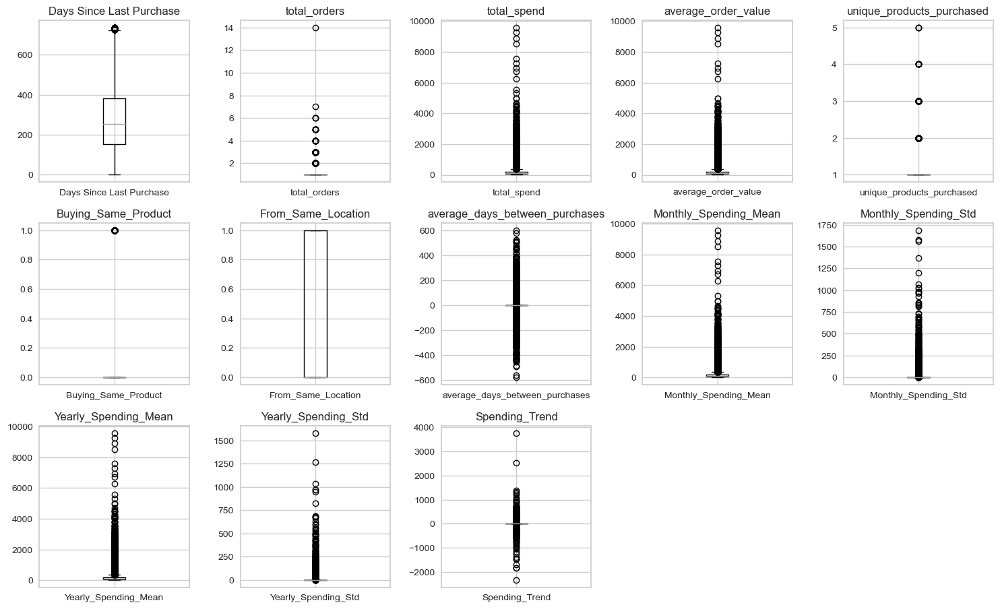

In [107]:
# Plotting box plots for each feature
plt.figure(figsize=(15, 15))
for i, column in enumerate(customer_engagement.columns[1:], 1):
    plt.subplot(5, 5, i)
    customer_engagement.boxplot(column=column)
    plt.title(column)

plt.tight_layout()
plt.show()

## Isolation Forest Algorithm

The Isolation Forest algorithm is a tree-based anomaly detection algorithm that works by isolating anomalies in the dataset. The algorithm constructs a set of trees, where each tree is built by selecting a random feature and a random split value. The algorithm then recursively applies this process to the dataset until each data point is isolated. The intuition behind this algorithm is that anomalies are easier to isolate than normal data points, and therefore, the algorithm can identify anomalies by counting the number of splits required to isolate each data point.

The Isolation Forest algorithm is implemented in the scikit-learn library, which provides an implementation of the algorithm in the IsolationForest class. The algorithm takes as input the dataset and a contamination parameter, which is used to estimate the number of outliers in the dataset. The algorithm then fits the model to the dataset and predicts the outlier score for each data point.

In [108]:
# Initializing the IsolationForest model with a contamination parameter of 0.05
model = IsolationForest(contamination=0.05, random_state=0)

# Fitting the model on our dataset (converting DataFrame to NumPy to avoid warning)
customer_engagement['Outlier_Scores'] = model.fit_predict(customer_engagement.iloc[:, 1:].to_numpy())

# Creating a new column to identify outliers (1 for inliers and -1 for outliers)
customer_engagement['Is_Outlier'] = [1 if x == -1 else 0 for x in customer_engagement['Outlier_Scores']]
customer_engagement

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend,Outlier_Scores,Is_Outlier
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0,141.90,0.0,141.90,0.0,0.0,1,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0,27.19,0.0,27.19,0.0,0.0,1,0
3,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0,43.62,0.0,43.62,0.0,0.0,1,0
4,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0,196.89,0.0,196.89,0.0,0.0,1,0
5,0004bd2a26a76fe21f786e4fbd80607f,193,1,166.98,166.98,1,0.0,0.0,0.0,166.98,0.0,166.98,0.0,0.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91459,fffb09418989a0dbff854a28163e47c6,295,1,73.16,73.16,1,0.0,1.0,0.0,73.16,0.0,73.16,0.0,0.0,1,0
91460,fffcf5a5ff07b0908bd4e2dbc735a684,468,1,4134.84,4134.84,1,0.0,1.0,0.0,4134.84,0.0,4134.84,0.0,0.0,-1,1
91462,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0,112.46,0.0,112.46,0.0,0.0,1,0
91463,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0,133.69,0.0,133.69,0.0,0.0,1,0


The outlier score is a measure of how likely a data point is to be an outlier. The algorithm assigns a score of 1 to data points that are likely to be inliers and a score of -1 to data points that are likely to be outliers. The algorithm then uses this score to identify and handle outliers in the dataset.

'Is_Outlier' is a binary column that indicates whether the data point is an outlier or not. For outliers, the value is 1, while for inliers, the value is 0.

In [109]:
# Calculate the percentage of inliers and outliers
outlier_percentage = customer_engagement['Is_Outlier'].value_counts(normalize=True) * 100
outlier_percentage

0    94.999814
1     5.000186
Name: Is_Outlier, dtype: float64

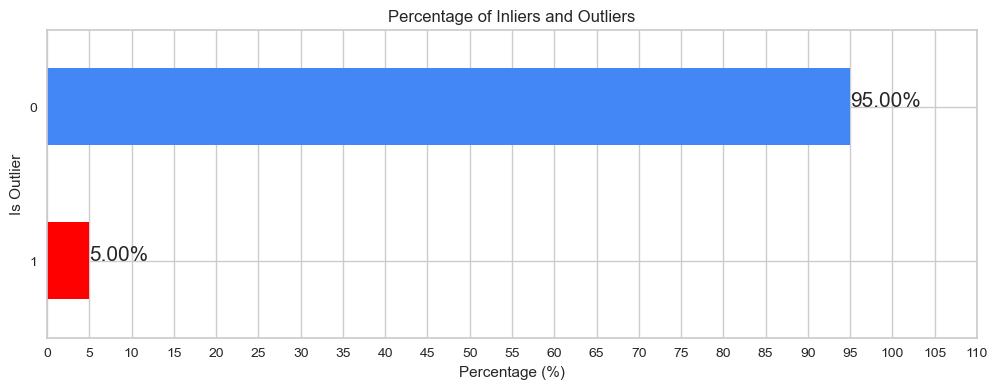

In [110]:
# Plotting the percentage of inliers and outliers
plt.figure(figsize=(12, 4))
outlier_percentage.plot(kind='barh', color=['#4287f5', '#ff0000'])

# Adding the percentage labels on the bars
for index, value in enumerate(outlier_percentage):
    plt.text(value, index, f'{value:.2f}%', fontsize=15)

plt.title('Percentage of Inliers and Outliers')
plt.xticks(ticks=np.arange(0, 115, 5))
plt.xlabel('Percentage (%)')
plt.ylabel('Is Outlier')
plt.gca().invert_yaxis()
plt.show()

In [111]:
# Separate the outliers for analysis
outliers_data = customer_engagement[customer_engagement['Is_Outlier'] == 1]

# Remove the outliers from the main dataset
customer_engagement_cleaned = customer_engagement[customer_engagement['Is_Outlier'] == 0]

# Drop the 'Outlier_Scores' and 'Is_Outlier' columns
customer_engagement_cleaned = customer_engagement_cleaned.drop(columns=['Outlier_Scores', 'Is_Outlier'])

# Reset the index of the cleaned data
customer_engagement_cleaned.reset_index(drop=True, inplace=True)

In [112]:
# Getting the number of rows in the cleaned customer dataset
customer_engagement_cleaned.shape[0]

76548

In [113]:
customer_engagement_cleaned

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0,141.90,0.0,141.90,0.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0,27.19,0.0,27.19,0.0,0.0
2,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0,43.62,0.0,43.62,0.0,0.0
3,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0,196.89,0.0,196.89,0.0,0.0
4,0004bd2a26a76fe21f786e4fbd80607f,193,1,166.98,166.98,1,0.0,0.0,0.0,166.98,0.0,166.98,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76543,fffa431dd3fcdefea4b1777d114144f2,341,1,81.20,81.20,1,0.0,1.0,0.0,81.20,0.0,81.20,0.0,0.0
76544,fffb09418989a0dbff854a28163e47c6,295,1,73.16,73.16,1,0.0,1.0,0.0,73.16,0.0,73.16,0.0,0.0
76545,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0,112.46,0.0,112.46,0.0,0.0
76546,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0,133.69,0.0,133.69,0.0,0.0


# Correlation Analysis

Correlation analysis helps identify which features are strongly related to each other. Multicollinearity occurs when two or more features are highly correlated. In K-means, multicollinearity can lead to biased cluster assignments. Reducing dimensionality simplifies the clustering process. Techniques like Principal Component Analysis (PCA) can be applied based on correlations.

The correlation coefficient can take on values between -1 and +1, with the strength of the relationship being indicated by the absolute value of the correlation coefficient. The most common formula for calculating the correlation coefficient is the Pearson Correlation coefficient formula, which is used for linear dependency between the data sets:

r = (nΣxy - ΣxΣy) / sqrt[(nΣx^2 - (Σx)^2)(nΣy^2 - (Σy)^2)]

where n is the quantity of information, Σx is the total of the first variable value, Σy is the total of the second variable value, Σxy is the sum of the product of the first and second value, Σx^2 is the sum of the squares of the first value, and Σy^2 is the sum of the squares of the second value

Color Coding:

Darker colors represent stronger correlations.

Lighter colors indicate weaker correlations.

Positive correlations (when one variable increases, the other tends to increase) are usually shown in warm colors.

Negative correlations (when one variable increases, the other tends to decrease) are usually shown in cool colors.

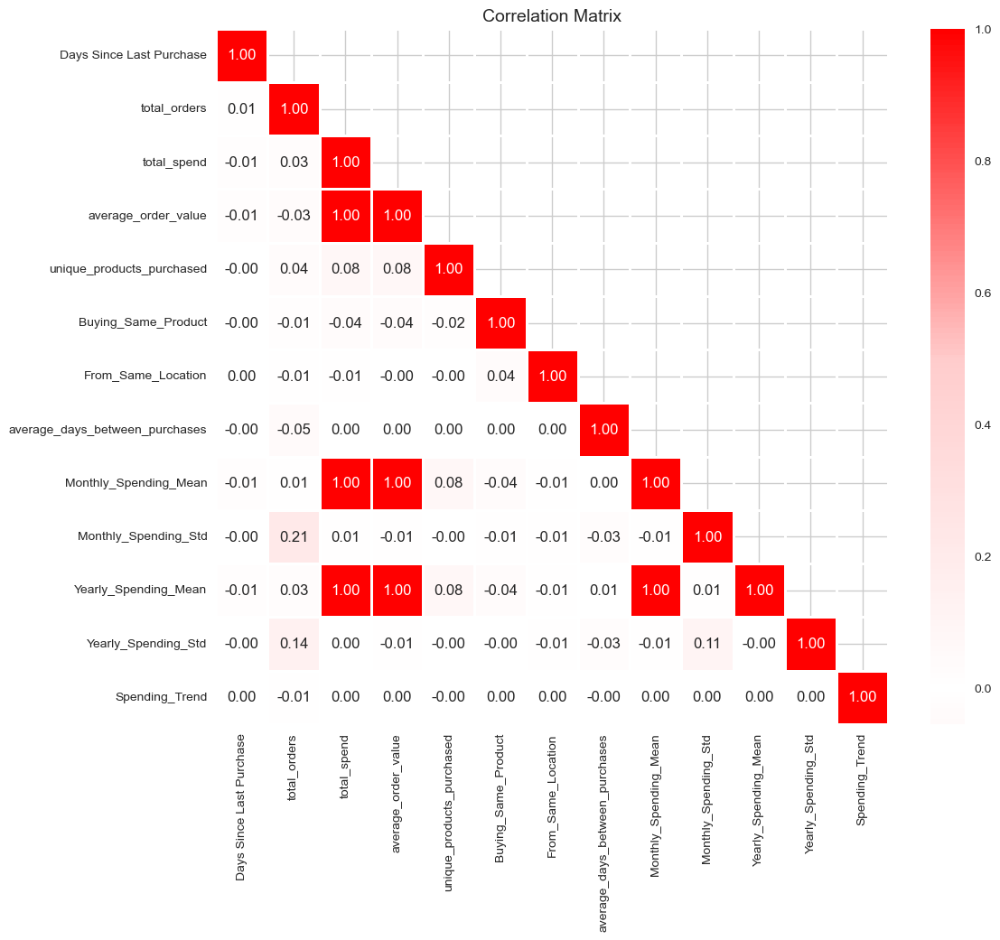

In [114]:
# Reset background style
sns.set_style('whitegrid')

# Calculate the correlation matrix excluding the 'customer_unique_id' column
corr = customer_engagement_cleaned.drop(columns=['customer_unique_id']).corr()

# Define a custom colormap
colors = ['#ff0000', '#ffcccc', 'white', '#ffcccc', '#ff0000']
my_cmap = LinearSegmentedColormap.from_list('custom_map', colors, N=256)

# Create a mask to only show the lower triangle of the matrix (since it's mirrored around its top-left to bottom-right diagonal)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, k=1)] = True

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr, mask=mask, cmap=my_cmap, annot=True, center=0, fmt='.2f', linewidths=2)
plt.title('Correlation Matrix', fontsize=14)
plt.show()

Pairs of variables that have high correlations:

average_order_value & total_spend

Monthly_Spending_Mean & total_spend

Monthly_Spending_Mean & average_order_value

Yearly_Spending_Mean & total_spend

Yearly_Spending_Mean & average_order_value

Yearly_Spending_Mean & Monthly_Spending_Mean

Now to achive uncorrelated variables, have to apply PCA technique.

# Feature Scaling using Standardization Technique

In machine learning, feature scaling is crucial to ensure that all features are on a comparable scale and have comparable ranges. This is especially important if you are using distance-based algorithms like K-nearest neighbors, K-means clustering, or Principal Component Analysis (PCA).

Standardization is a feature scaling technique that rescales the features to have a mean of 0 and a standard deviation of 1. This technique is also known as Z-score normalization. The standard score, z, of a sample x is calculated as:

z = (x - μ) / σ

where μ is the mean of the feature and σ is the standard deviation of the feature.

In [115]:
# Initialize the StandardScaler
scaler = StandardScaler()

# List of columns that don't need to be scaled
columns_to_exclude = ['customer_unique_id', 'total_orders', 'unique_products_purchased', 'Buying_Same_Product', 'From_Same_Location']

# List of columns that need to be scaled
columns_to_scale = customer_engagement_cleaned.columns.difference(columns_to_exclude)

# Copy the cleaned dataset
customer_engagement_scaled = customer_engagement_cleaned.copy()

# Applying the scaler to the necessary columns in the dataset
customer_engagement_scaled[columns_to_scale] = scaler.fit_transform(customer_engagement_scaled[columns_to_scale])
customer_engagement_scaled

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend
0,0000366f3b9a7992bf8c76cfdf3221e2,-0.788565,1,0.015027,0.020546,1,0.0,1.0,0.004152,0.016633,-0.018104,0.015200,-0.008061,-0.00196
1,0000b849f77a49e4a4ce2b2a4ca5be3f,-0.748952,1,-0.936622,-0.932850,1,0.0,0.0,0.004152,-0.935584,-0.018104,-0.936465,-0.008061,-0.00196
2,0000f6ccb0745a6a4b88665a16c9f078,0.505465,1,-0.800316,-0.796294,1,0.0,0.0,0.004152,-0.799197,-0.018104,-0.800158,-0.008061,-0.00196
3,0004aac84e0df4da2b147fca70cf8255,0.333808,1,0.471232,0.477588,1,0.0,0.0,0.004152,0.473109,-0.018104,0.471411,-0.008061,-0.00196
4,0004bd2a26a76fe21f786e4fbd80607f,-0.531079,1,0.223094,0.228995,1,0.0,0.0,0.004152,0.224824,-0.018104,0.223270,-0.008061,-0.00196
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76543,fffa431dd3fcdefea4b1777d114144f2,0.446046,1,-0.488548,-0.483953,1,0.0,1.0,0.004152,-0.487243,-0.018104,-0.488384,-0.008061,-0.00196
76544,fffb09418989a0dbff854a28163e47c6,0.142345,1,-0.555249,-0.550777,1,0.0,1.0,0.004152,-0.553983,-0.018104,-0.555086,-0.008061,-0.00196
76545,ffff371b4d645b6ecea244b27531430a,2.169219,1,-0.229211,-0.224140,1,0.0,0.0,0.004152,-0.227751,-0.018104,-0.229043,-0.008061,-0.00196
76546,ffff5962728ec6157033ef9805bacc48,-0.775361,1,-0.053084,-0.047690,1,0.0,0.0,0.004152,-0.051519,-0.018104,-0.052913,-0.008061,-0.00196


Standardization ensures that each feature contributes equally to the algorithm. It prevents biased clusters based on feature magnitudes. Scaling ensures similar ranges for all features, which accelerates convergence and leads to quicker model training.

# Dimensionality Reduction using PCA

Principal Component Analysis (PCA) is a technique used for dimensionality reduction, which is the process of reducing the number of features in a dataset while retaining most of the information. PCA is an unsupervised learning algorithm that uses mathematical principles to transform the data into a new set of uncorrelated features called principal components.

The mathematical concepts behind PCA include eigenvectors and eigenvalues. An eigenvector is a vector that, when multiplied by a square matrix, results in a scalar multiple of the vector. The scalar is called the eigenvalue. In the context of PCA, the eigenvectors represent the directions of maximum variance in the data, and the eigenvalues represent the magnitudes of those directions.

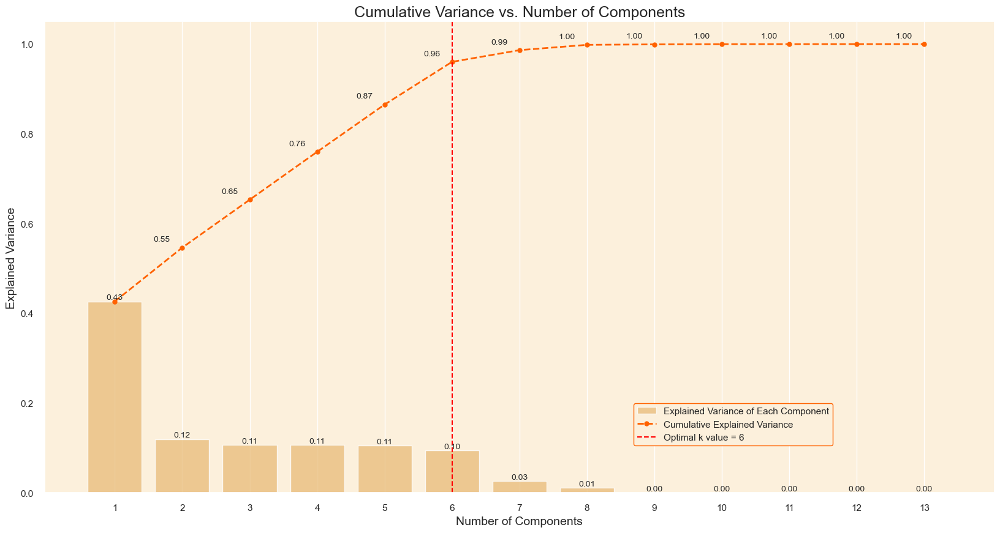

In [116]:
# Setting customer_unique_id as the index column
customer_engagement_scaled.set_index('customer_unique_id', inplace=True)

# Apply PCA
pca = PCA().fit(customer_engagement_scaled)

# Calculate the Cumulative Sum of the Explained Variance
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

# Set the optimal k value
optimal_k = 6

# Set seaborn plot style
sns.set(rc={'axes.facecolor': '#fcf0dc'}, style='darkgrid')

# Plot the cumulative explained variance against the number of components
plt.figure(figsize=(20, 10))

# Bar chart for the explained variance of each component
barplot = sns.barplot(x=list(range(1, len(cumulative_explained_variance) + 1)), y=explained_variance_ratio, color='#fcc36d', alpha=0.8)

# Line plot for the cumulative explained variance
lineplot, = plt.plot(range(0, len(cumulative_explained_variance)), cumulative_explained_variance, marker='o', linestyle='--', color='#ff6200', linewidth=2)

# Plot optimal k value line
optimal_k_line = plt.axvline(optimal_k - 1, color='red', linestyle='--', label=f'Optimal k value = {optimal_k}') 

# Set labels and title
plt.xlabel('Number of Components', fontsize=14)
plt.ylabel('Explained Variance', fontsize=14)
plt.title('Cumulative Variance vs. Number of Components', fontsize=18)

# Customize ticks and legend
plt.xticks(range(0, len(cumulative_explained_variance)))
plt.legend(handles=[barplot.patches[0], lineplot, optimal_k_line], labels=['Explained Variance of Each Component', 'Cumulative Explained Variance', f'Optimal k value = {optimal_k}'], loc=(0.62, 0.1), frameon=True, framealpha=1.0,   edgecolor='#ff6200')  

# Display the variance values for both graphs on the plots
x_offset = -0.3
y_offset = 0.01
for i, (ev_ratio, cum_ev_ratio) in enumerate(zip(explained_variance_ratio, cumulative_explained_variance)):
    plt.text(i, ev_ratio, f"{ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)
    if i > 0:
        plt.text(i + x_offset, cum_ev_ratio + y_offset, f"{cum_ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)

plt.grid(axis='both')   
plt.show()

When selecting the optimal number of components, we typically seek a point where adding another component no longer significantly boosts the cumulative explained variance, often termed as the "elbow point" in the curve.

From the plotted data, it's evident that the increase in cumulative variance begins to down after the 6th component, accounting for 96% of the total variance.

Considering the objective of customer segmentation, our aim is to retain adequate information to effectively identify distinct customer groups. Hence, retaining the first 6 components appears to strike a balance. These components collectively explain a substantial portion of the total variance while simultaneously reducing the dataset's dimensionality.

In [117]:
# Creating a PCA object with 6 components
pca = PCA(n_components=6)

# Fitting and transforming the original data to the new PCA dataframe
customer_engagement_pca = pca.fit_transform(customer_engagement_scaled)

# Creating a new dataframe from the PCA dataframe, with columns labeled PC1, PC2, etc.
customer_engagement_pca = pd.DataFrame(customer_engagement_pca, columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Adding the UserID index back to the new PCA dataframe
customer_engagement_pca.index = customer_engagement_scaled.index
customer_engagement_pca

,PC1,PC2,PC3,PC4,PC5,PC6
customer_unique_id,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.041267,-0.004637,0.594480,-0.501182,-0.121194,-0.014763
0000b849f77a49e4a4ce2b2a4ca5be3f,-1.862062,-0.002231,0.579925,-0.490109,-0.111695,-0.021304
0000f6ccb0745a6a4b88665a16c9f078,-1.601187,-0.029667,-0.368371,0.311805,0.076442,0.016318
0004aac84e0df4da2b147fca70cf8255,0.944880,-0.022525,-0.255447,0.220828,0.048225,0.018508
0004bd2a26a76fe21f786e4fbd80607f,0.456534,-0.004014,0.400390,-0.334312,-0.081195,-0.008308
...,...,...,...,...,...,...
fffa431dd3fcdefea4b1777d114144f2,-0.978109,-0.033314,-0.330518,0.278798,0.065195,0.018637
fffb09418989a0dbff854a28163e47c6,-1.108705,-0.026760,-0.100490,0.084160,0.019710,0.009337
ffff371b4d645b6ecea244b27531430a,-0.474128,-0.065030,-1.631207,1.381071,0.325224,0.068435


In [118]:
# Define a function to highlight the top 3 absolute values in each column of a dataframe
def top_3(column):
    top3 = column.abs().nlargest(3).index
    return ['background-color:  #ffeacc' if i in top3 else '' for i in column.index]

# Create the PCA component DataFrame and apply the highlighting function
pc_df = pd.DataFrame(pca.components_.T, columns=['PC{}'.format(i+1) for i in range(pca.n_components_)],  
                     index=customer_engagement_scaled.columns)

pc_df.style.apply(top_3, axis=0)

,PC1,PC2,PC3,PC4,PC5,PC6
Days Since Last Purchase,-0.009471,-0.022156,-0.754547,0.637692,0.150188,0.029373
total_orders,0.000399,0.020077,-0.000201,0.001748,0.002571,-0.005270
total_spend,0.500066,0.008192,-0.003129,0.003918,0.001519,-0.001612
average_order_value,0.499600,-0.004996,-0.003351,0.002835,-0.002511,0.006167
unique_products_purchased,0.002725,-0.000090,0.000015,0.000065,0.000099,0.000062
Buying_Same_Product,-0.007023,-0.002455,-0.000443,-0.002100,-0.000095,0.001028
From_Same_Location,-0.001351,-0.005782,-0.002911,0.000351,-0.001726,0.002291
average_days_between_purchases,0.002857,-0.310073,0.082110,-0.133754,0.937557,-0.013552
Monthly_Spending_Mean,0.500082,-0.004897,-0.003293,0.003974,-0.002561,0.006126
Monthly_Spending_Std,0.001249,0.673447,-0.002284,0.003068,0.213204,-0.707397


# K-Means Clustering

## Determining the Optimal Number of Clusters:

### Elbow Method: 

The Elbow Method is a graphical approach for determining the optimal number of clusters. The Elbow Method can be implemented using the following steps:

a. Compute the sum of squared distances for a range of cluster values.

b. Plot the sum of squared distances against the number of clusters.

c. Identify the 'elbow' point in the plot, which represents the optimal number of clusters.

The mathematical formula for the sum of squared distances is:

Sum of squared distances = Σ(xi - ci)^2

where xi is the ith data point in the cluster, and ci is the centroid of the cluster.

Pros:

Simple and intuitive.

Provides a visual clue for choosing K.

Cons:

Ambiguous if the plot lacks a clear elbow point.

Doesn’t work well for non-convex clusters.

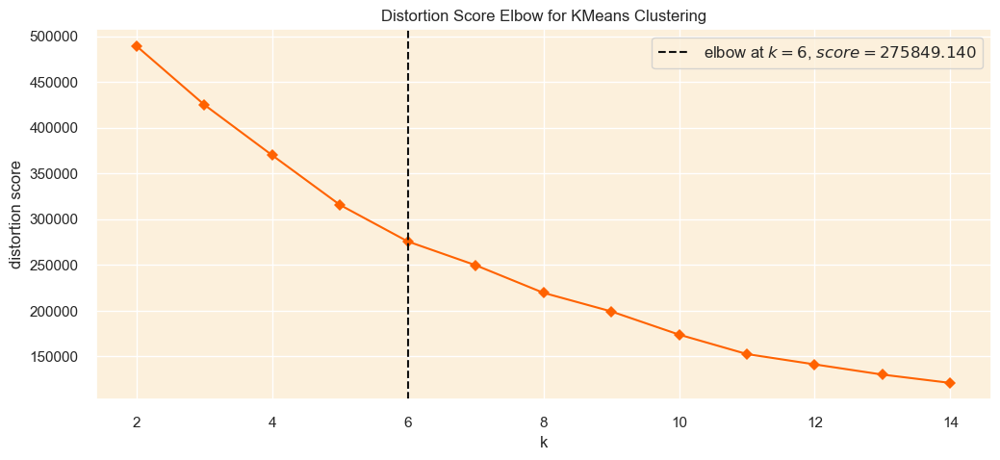

In [119]:
# Set plot style, and background color
sns.set(style='darkgrid', rc={'axes.facecolor': '#fcf0dc'})

# Set the color palette for the plot
sns.set_palette(['#ff6200'])

# Instantiate the clustering model with the specified parameters
km = KMeans(init='k-means++', n_init=10, max_iter=100, random_state=0)

# Create a figure and axis with the desired size
fig, ax = plt.subplots(figsize=(12, 5))

# Instantiate the KElbowVisualizer with the model and range of k values, and disable the timing plot
visualizer = KElbowVisualizer(km, k=(2, 15), timings=False, ax=ax)

# Fit the data to the visualizer
visualizer.fit(customer_engagement_pca)

# Finalize and render the figure
visualizer.show();

### Silhouette Method: 

The Silhouette Method is a quantitative approach for determining the optimal number of clusters. The silhouette score ranges from -1 to 1, with a higher score indicating a more well-defined cluster. The Silhouette Method can be implemented using the following steps:

a. Compute the silhouette score for each data point for a range of cluster values.

b. Calculate the average silhouette score for each cluster value.

c. Identify the cluster value that maximizes the average silhouette score.

The mathematical formula for the silhouette score is:

Silhouette score = (b - a) / max(a, b)

where a is the average distance between the data point and other points in the same cluster, and b is the average distance between the data point and points in the next closest cluster.

Pros:

Considers both cohesion and separation.

Works well for non-convex clusters.

Cons:

Computationally expensive for large datasets.

Choosing Between Them:

Silhouette Method is better than Elbow Method.

In [120]:
# Perform Silhouette analysis for a range of k values and visualize the results.
def silhouette_analysis(df, start_k, stop_k, figsize=(15, 16)):
    # Set the size of the figure
    plt.figure(figsize=figsize)

    # Create a grid with (stop_k - start_k + 1) rows and 2 columns
    grid = gridspec.GridSpec(stop_k - start_k + 1, 2)

    # Assign the first plot to the first row and both columns
    first_plot = plt.subplot(grid[0, :])

    # First plot: Silhouette scores for different k values
    sns.set_palette(['darkorange'])

    silhouette_scores = []

    # Iterate through the range of k values
    for k in range(start_k, stop_k + 1):
        km = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=100, random_state=0)
        km.fit(df)
        labels = km.predict(df)
        score = silhouette_score(df, labels)
        silhouette_scores.append(score)

    best_k = start_k + silhouette_scores.index(max(silhouette_scores))

    plt.plot(range(start_k, stop_k + 1), silhouette_scores, marker='o')
    plt.xticks(range(start_k, stop_k + 1))
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Silhouette score')
    plt.title('Average Silhouette Score for Different k Values', fontsize=15)

    # Add the optimal k value text to the plot
    optimal_k_text = f'The k value with the highest Silhouette score is: {best_k}'
    plt.text(10, 0.23, optimal_k_text, fontsize=12, verticalalignment='bottom', horizontalalignment='left', bbox=dict(facecolor='#fcc36d', edgecolor='#ff6200', boxstyle='round, pad=0.5'))

    # Second plot (subplot): Silhouette plots for each k value
    colors = sns.color_palette("bright")

    for i in range(start_k, stop_k + 1):    
        km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=0)
        row_idx, col_idx = divmod(i - start_k, 2)

        # Assign the plots to the second, third, and fourth rows
        ax = plt.subplot(grid[row_idx + 1, col_idx])

        visualizer = SilhouetteVisualizer(km, colors=colors, ax=ax)
        visualizer.fit(df)

        # Add the Silhouette score text to the plot
        score = silhouette_score(df, km.labels_)
        ax.text(0.97, 0.02, f'Silhouette Score: {score:.2f}', fontsize=12, ha='right', transform=ax.transAxes, color='red')

        ax.set_title(f'Silhouette Plot for {i} Clusters', fontsize=15)

    plt.tight_layout()
    plt.show()

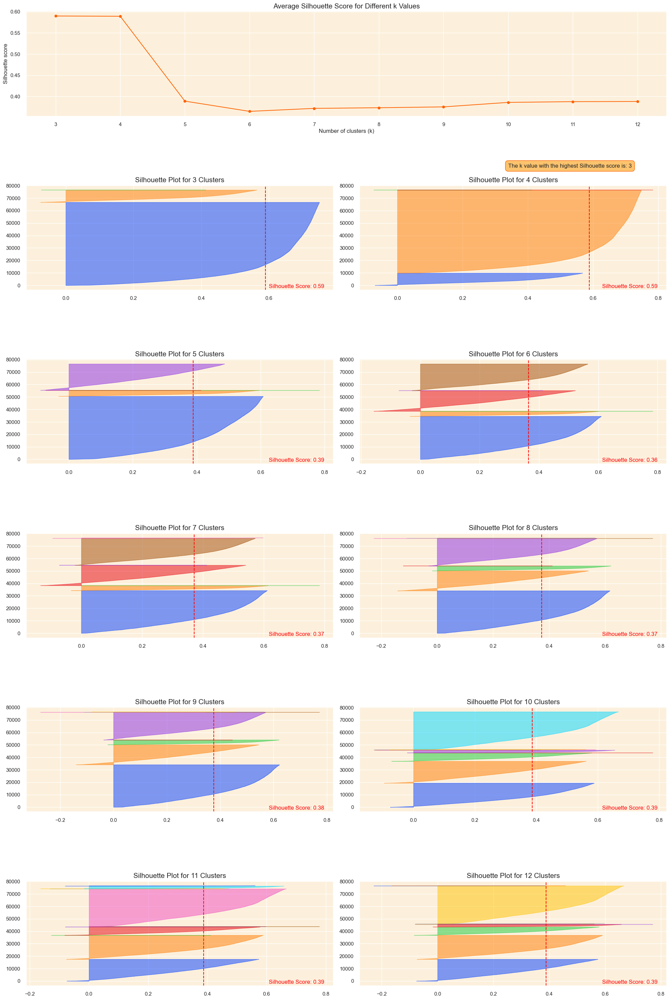

In [121]:
silhouette_analysis(customer_engagement_pca, 3, 12, figsize=(20, 50))

### To interpret silhouette plots and determine the optimal number of clusters (k), the following criteria are considered:

##### Silhouette Plot Analysis:-

###### Silhouette Score Width:

Wide Widths (closer to +1): Indicate well-separated clusters, with data points distinct from other clusters.

Narrow Widths (closer to -1): Suggest poorly defined clusters, where data points are not distinctly separated.

###### Average Silhouette Score:

High Average Width: Reflects well-separated clusters.

Low Average Width: Indicates poor separation between clusters.

##### Uniformity in Cluster Size:-

###### Cluster Thickness:

Uniform Thickness: Suggests balanced clusters with a roughly equal number of data points.

Variable Thickness: Signifies an uneven distribution of data points across clusters.

##### Peaks in Average Silhouette Score:-

Clear Peaks: Indicate potential optimal k values.

##### Minimize Fluctuations in Silhouette Plot Widths:-

Uniform Widths: Prefer silhouette plots with consistent widths across clusters.

Variable Widths: Avoid fluctuations, suggesting poorly defined clusters.

##### Optimal Cluster Selection:-

Maximize Overall Average Silhouette Score: Choose the k value with the highest average silhouette score across clusters.

Avoid Below-Average Scores: Ensure most clusters have above-average silhouette scores to maintain optimal clustering.

##### Visual Inspection of Silhouette Plots:-

Consistent Cluster Formation: Visually examine silhouette plots for consistent and structured clusters.

Cluster Compactness: Look for compact clusters, with data points having silhouette scores closer to +1, indicating better clustering.

## Apply Clustering Model K-means:

K-means clustering is an unsupervised machine learning algorithm that groups similar data points into distinct, non-overlapping subsets called clusters. The goal of the algorithm is to minimize the variance within each cluster and maximize the variance between clusters.

The mathematical concept behind K-means clustering involves minimizing the sum of squared distances between the data points and their corresponding cluster centroids. The objective function can be expressed as:

J(C) = Σ(i=1)^n Σ(j=1)^K ||x_i - c_j||^2

where n is the number of data points, K is the number of clusters, x_i is the ith data point, c_j is the centroid of the jth cluster, and ||.|| is the Euclidean distance.

The K-means algorithm can be summarized in the following steps:

1. Initialize K centroids randomly.

2. Assign each data point to the nearest centroid.

3. Update the centroids based on the mean of the data points in each cluster.

4. Repeat steps 2 and 3 until the centroids converge or a maximum number of iterations has been reached.

In [122]:
# Apply KMeans clustering using the optimal k
kmeans = KMeans(n_clusters=3, init='k-means++', n_init=10, max_iter=100, random_state=0)
kmeans.fit(customer_engagement_pca)

# Get the frequency of each cluster
cluster_frequencies = Counter(kmeans.labels_)

# Create a mapping from old labels to new labels based on frequency
label_mapping = {label: new_label for new_label, (label, _) in enumerate(cluster_frequencies.most_common())}

# Reverse the mapping to assign labels as per your criteria
label_mapping = {v: k for k, v in {2: 0, 1: 1, 0: 2}.items()}

# Apply the mapping to get the new labels
new_labels = np.array([label_mapping[label] for label in kmeans.labels_])

# Append the new cluster labels back to the original dataset
customer_engagement_cleaned['cluster'] = new_labels

# Append the new cluster labels to the PCA version of the dataset
customer_engagement_pca['cluster'] = new_labels

In [123]:
customer_engagement_cleaned

,customer_unique_id,Days Since Last Purchase,total_orders,total_spend,average_order_value,unique_products_purchased,Buying_Same_Product,From_Same_Location,average_days_between_purchases,Monthly_Spending_Mean,Monthly_Spending_Std,Yearly_Spending_Mean,Yearly_Spending_Std,Spending_Trend,cluster
0,0000366f3b9a7992bf8c76cfdf3221e2,154,1,141.90,141.90,1,0.0,1.0,0.0,141.90,0.0,141.90,0.0,0.0,2
1,0000b849f77a49e4a4ce2b2a4ca5be3f,160,1,27.19,27.19,1,0.0,0.0,0.0,27.19,0.0,27.19,0.0,0.0,2
2,0000f6ccb0745a6a4b88665a16c9f078,350,1,43.62,43.62,1,0.0,0.0,0.0,43.62,0.0,43.62,0.0,0.0,2
3,0004aac84e0df4da2b147fca70cf8255,324,1,196.89,196.89,1,0.0,0.0,0.0,196.89,0.0,196.89,0.0,0.0,2
4,0004bd2a26a76fe21f786e4fbd80607f,193,1,166.98,166.98,1,0.0,0.0,0.0,166.98,0.0,166.98,0.0,0.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76543,fffa431dd3fcdefea4b1777d114144f2,341,1,81.20,81.20,1,0.0,1.0,0.0,81.20,0.0,81.20,0.0,0.0,2
76544,fffb09418989a0dbff854a28163e47c6,295,1,73.16,73.16,1,0.0,1.0,0.0,73.16,0.0,73.16,0.0,0.0,2
76545,ffff371b4d645b6ecea244b27531430a,602,1,112.46,112.46,1,0.0,0.0,0.0,112.46,0.0,112.46,0.0,0.0,2
76546,ffff5962728ec6157033ef9805bacc48,156,1,133.69,133.69,1,0.0,0.0,0.0,133.69,0.0,133.69,0.0,0.0,2


In [124]:
customer_engagement_pca

,PC1,PC2,PC3,PC4,PC5,PC6,cluster
customer_unique_id,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.041267,-0.004637,0.594480,-0.501182,-0.121194,-0.014763,2
0000b849f77a49e4a4ce2b2a4ca5be3f,-1.862062,-0.002231,0.579925,-0.490109,-0.111695,-0.021304,2
0000f6ccb0745a6a4b88665a16c9f078,-1.601187,-0.029667,-0.368371,0.311805,0.076442,0.016318,2
0004aac84e0df4da2b147fca70cf8255,0.944880,-0.022525,-0.255447,0.220828,0.048225,0.018508,2
0004bd2a26a76fe21f786e4fbd80607f,0.456534,-0.004014,0.400390,-0.334312,-0.081195,-0.008308,2
...,...,...,...,...,...,...,...
fffa431dd3fcdefea4b1777d114144f2,-0.978109,-0.033314,-0.330518,0.278798,0.065195,0.018637,2
fffb09418989a0dbff854a28163e47c6,-1.108705,-0.026760,-0.100490,0.084160,0.019710,0.009337,2
ffff371b4d645b6ecea244b27531430a,-0.474128,-0.065030,-1.631207,1.381071,0.325224,0.068435,2


# Clustering Evaluation

## 3D Visualization of Top Principal Components

In [125]:
# Setting up the color scheme for the clusters (RGB order)
colors = ['#1ac938', '#023eff', '#ff7c00']

# Create separate data frames for each cluster
cluster_0 = customer_engagement_pca[customer_engagement_pca['cluster'] == 0]
cluster_1 = customer_engagement_pca[customer_engagement_pca['cluster'] == 1]
cluster_2 = customer_engagement_pca[customer_engagement_pca['cluster'] == 2]

# Create a 3D scatter plot
fig = go.Figure()

# Add data points for each cluster separately and specify the color
fig.add_trace(go.Scatter3d(x=cluster_0['PC1'], y=cluster_0['PC2'], z=cluster_0['PC3'], mode='markers', marker=dict(color=colors[0], size=5, opacity=0.4), name='Cluster 0'))
fig.add_trace(go.Scatter3d(x=cluster_1['PC1'], y=cluster_1['PC2'], z=cluster_1['PC3'], mode='markers', marker=dict(color=colors[1], size=5, opacity=0.4), name='Cluster 1'))
fig.add_trace(go.Scatter3d(x=cluster_2['PC1'], y=cluster_2['PC2'], z=cluster_2['PC3'], mode='markers', marker=dict(color=colors[2], size=5, opacity=0.4), name='Cluster 2'))

# Set the title and layout details
fig.update_layout(
    title=dict(text='3D Visualization of Customer Clusters in PCA Space with 3 Clusters', x=0.5),
    scene=dict(
        xaxis=dict(backgroundcolor="#fcf0dc", gridcolor='white', title='PC1'),
        yaxis=dict(backgroundcolor="#fcf0dc", gridcolor='white', title='PC2'),
        zaxis=dict(backgroundcolor="#fcf0dc", gridcolor='white', title='PC3'),
    ),
    width=900,
    height=800
)

# Show the plot
fig.show()

## Cluster Distribution Visualization

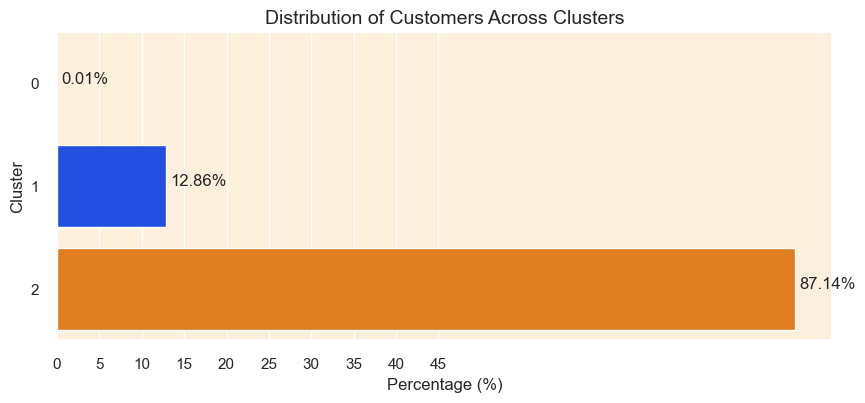

In [126]:
# Calculate the percentage of customers in each cluster
cluster_percentage = (customer_engagement_pca['cluster'].value_counts(normalize=True) * 100).reset_index()
cluster_percentage.columns = ['Cluster', 'Percentage']
cluster_percentage.sort_values(by='Cluster', inplace=True)

# Create a horizontal bar plot
plt.figure(figsize=(10, 4))
sns.barplot(x='Percentage', y='Cluster', data=cluster_percentage, orient='h', palette=colors)

# Adding percentages on the bars
for index, value in enumerate(cluster_percentage['Percentage']):
    plt.text(value+0.5, index, f'{value:.2f}%')

plt.title('Distribution of Customers Across Clusters', fontsize=14)
plt.xticks(ticks=np.arange(0, 50, 5))
plt.xlabel('Percentage (%)')

# Show the plot
plt.show()

Cluster 2 is the best cluster having highest percentage of customers.

## Evaluation Metrics

The Silhouette score, Calinski-Harabasz index, and Davies-Bouldin index are used as internal evaluation metrics to assess the quality of the clustering results obtained from the K-means algorithm.

### Silhouette Score:

The Silhouette Score is a measure of how well each data point fits into its assigned cluster. It ranges from -1 to 1, where a higher score indicates that the data point is well-matched to its assigned cluster and poorly matched to neighboring clusters. The Silhouette Score is calculated as:

Silhouette Score = (b(i) - a(i)) / max(a(i), b(i))

where, a(i) is the average distance between the i-th data point and all other points in the same cluster,

& b(i) is the average distance between the i-th data point and all points in the neighboring cluster that it is most similar to.

A higher Silhouette Score indicates better-defined clusters.

### Davies-Bouldin Index (DBI):

The Davies-Bouldin Index (DBI) is a measure of the similarity between clusters. It ranges from 0 to infinity, where a lower score indicates that the clusters are well-separated and distinct. The DBI is calculated as:

DBI = (1/n) * Σ(R_i)

where, n is the number of clusters,

& R_i is the similarity between the i-th cluster and its most similar neighboring cluster, calculated as:

R_i = (s_i + s_j) / d(c_i, c_j)

where, s_i and s_j are the average distances between all points in the i-th and j-th clusters, respectively,

& d(c_i, c_j) is the distance between the centroids of the i-th and j-th clusters.

A lower DBI score indicates better-defined clusters.

### Calinski-Harabasz Index (CH):

The Calinski-Harabasz Index (CH) is a measure of the dispersion between and within clusters. It ranges from 0 to infinity, where a higher score indicates that the clusters are well-separated and distinct. The CH is calculated as:

CH = (B / (K-1)) / (W / (N-K))

where, B is the between-cluster dispersion, calculated as the sum of the squared distances between each cluster centroid and the overall centroid, calculated as: B =∑(n_i * ||c_i - c||^2), where, n_i is the number of points in cluster C_i, c_i is the centroid of cluster C_i, c is the overall centroid of the data & ||c_i - c||^2 represents the squared Euclidean distance between the centroid of cluster C_i and the overall centroid of the data.

W is the within-cluster dispersion, calculated as the sum of the squared distances between each data point and its cluster centroid, calculated as: W = ∑∑(||x - c_i||^2), where, x is a data point, c_i is the centroid of the cluster to which x belongs & ||x - c_i||^2 represents the squared Euclidean distance between the data point x and its cluster centroid c_i.

N is the total number of data points,

& K is the number of clusters.

A higher CH score indicates better-defined clusters.

In [127]:
# Compute number of customers
num_observations = len(customer_engagement_pca)

# Separate the features and the cluster labels
X = customer_engagement_pca.drop('cluster', axis=1)
clusters = customer_engagement_pca['cluster']

# Compute the metrics
sil_score = silhouette_score(X, clusters)
calinski_score = calinski_harabasz_score(X, clusters)
davies_score = davies_bouldin_score(X, clusters)

# Create a table to display the metrics and the number of observations
table_data = [
    ["Number of Observations", num_observations],
    ["Silhouette Score", sil_score],
    ["Calinski Harabasz Score", calinski_score],
    ["Davies Bouldin Score", davies_score]
]

# Print the table
print(tabulate(table_data, headers=["Metric", "Value"], tablefmt='pretty'))

+-------------------------+--------------------+
|         Metric          |       Value        |
+-------------------------+--------------------+
| Number of Observations  |       76548        |
|    Silhouette Score     | 0.5898565597161962 |
| Calinski Harabasz Score | 23699.108738424307 |
|  Davies Bouldin Score   | 0.6657791189023013 |
+-------------------------+--------------------+


Silhouette Score: This is a measure of how similar an object is to its own cluster (cohesion) compared to other clusters (separation). The silhouette score ranges from -1 to 1, where a high value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. A score of 0 indicates overlapping clusters. In this case, the silhouette score is approximately 0.5898, indicating a reasonable clustering structure.

Calinski Harabasz Score: This score, also known as the Variance Ratio Criterion, is a measure of the ratio between the within-cluster dispersion and the between-cluster dispersion. Higher values indicate better-defined clusters. In this case, the score is approximately 23699.1087.

Davies Bouldin Score: This score is defined as the average similarity between each cluster and its most similar cluster, where similarity is measured by the ratio of within-cluster distances to between-cluster distances. Lower values indicate better clustering, with 0 indicating the best possible score. In this case, the Davies Bouldin Score is approximately 0.6657, suggesting reasonable separation between clusters.

Overall, based on the silhouette score, the Calinski Harabasz score, and the Davies Bouldin score, it appears that the clustering algorithm has produced reasonably well-defined clusters in the dataset.

# Cluster Analysis and Profiling

## Radar Chart Approach

To create radar charts for visualizing the centroid values of each cluster across different features, we must initially calculate the centroid for each cluster. This centroid serves as the mean value for all features within a particular cluster. Afterward, we'll display these centroids on radar charts, enabling a straightforward visualization of the central tendencies of each feature across the clusters.

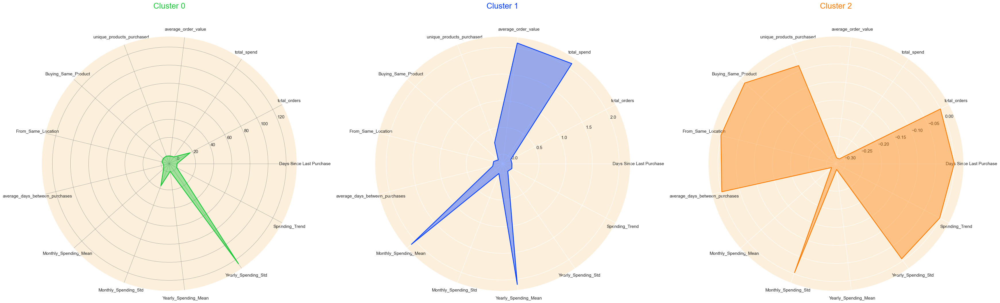

In [128]:
# Setting 'customer_unique_id' column as index and assigning it to a new dataframe
df_customer = customer_engagement_cleaned.set_index('customer_unique_id')

# Standardize the data (excluding the cluster column)
scaler = StandardScaler()
df_customer_standardized = scaler.fit_transform(df_customer.drop(columns=['cluster'], axis=1))

# Create a new dataframe with standardized values and add the cluster column back
df_customer_standardized = pd.DataFrame(df_customer_standardized, columns=df_customer.columns[:-1], index=df_customer.index)
df_customer_standardized['cluster'] = df_customer['cluster']

# Calculate the centroids of each cluster
cluster_centroids = df_customer_standardized.groupby('cluster').mean()

# Function to create a radar chart
def radar_chart(ax, angles, data, color, cluster):
    # Plot the data and fill the area
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2, linestyle='solid')
    
    # Add a title
    ax.set_title(f'Cluster {cluster}', size=20, color=color, y=1.1)

# Set data
labels=np.array(cluster_centroids.columns)
num_vars = len(labels)

# Compute angle of each axis
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# The plot is circular, so we need to "complete the loop" and append the start to the end
labels = np.concatenate((labels, [labels[0]]))
angles += angles[:1]

# Initialize the figure
fig, ax = plt.subplots(figsize=(35, 25), subplot_kw=dict(polar=True), nrows=1, ncols=3)

# Create radar chart for each cluster
for i, color in enumerate(colors):
    data = cluster_centroids.loc[i].tolist()
    data += data[:1]  # Complete the loop
    radar_chart(ax[i], angles, data, color, i)

# Add input data
ax[0].set_xticks(angles[:-1])
ax[0].set_xticklabels(labels[:-1])

ax[1].set_xticks(angles[:-1])
ax[1].set_xticklabels(labels[:-1])

ax[2].set_xticks(angles[:-1])
ax[2].set_xticklabels(labels[:-1])

# Add a grid
ax[0].grid(color='grey', linewidth=0.5)

# Display the plot
plt.tight_layout()
plt.show()

## Histogram Chart Approach

We can validate the profiles identified from the radar charts by plotting histograms for each feature segmented by the cluster labels. These histograms provide a visual inspection of the distribution of feature values within each cluster, aiding in confirming or refining the profiles derived from the radar charts.

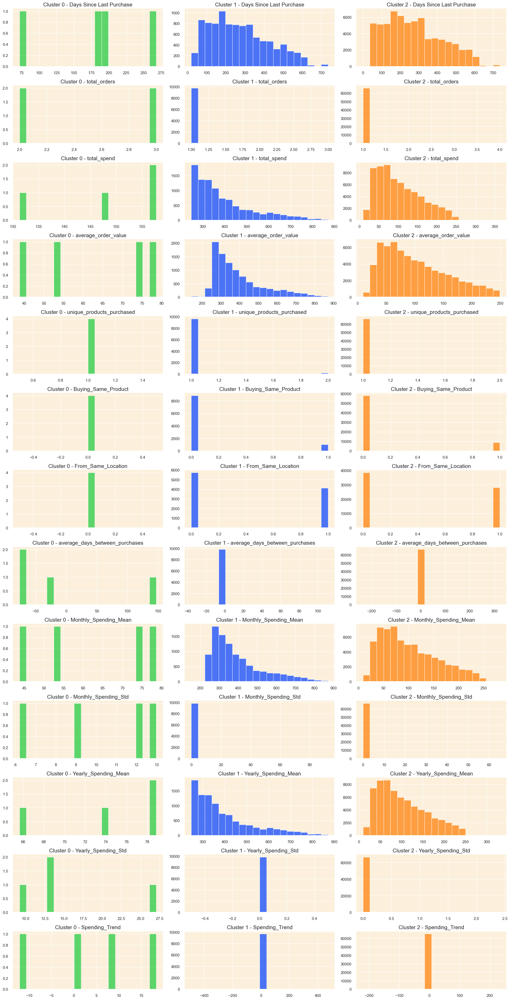

In [129]:
# Plot histograms for each feature segmented by the clusters
features = customer_engagement_cleaned.columns[1:-1]
clusters = customer_engagement_cleaned['cluster'].unique()
clusters.sort()

# Setting up the subplots
n_rows = len(features)
n_cols = len(clusters)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 3*n_rows))

# Plotting histograms
for i, feature in enumerate(features):
    for j, cluster in enumerate(clusters):
        data = customer_engagement_cleaned[customer_engagement_cleaned['cluster'] == cluster][feature]
        axes[i, j].hist(data, bins=20, color=colors[j], edgecolor='w', alpha=0.7)
        axes[i, j].set_title(f'Cluster {cluster} - {feature}', fontsize=15)
        axes[i, j].set_xlabel('')
        axes[i, j].set_ylabel('')

# Adjusting layout to prevent overlapping
plt.tight_layout()
plt.show()

cluster 1:

more frequently purchasing customers

more total spending customers

more average order/value customers

purchase more unique Products purhased customers

has best monthly spending mean and yearly spending mean

best spending trend

cluster 2:

many customers buy same product

many customers are from same location

has best average days between purchases customers

has the most monthly spending variability and yearly spending variability

cluster 0:

has highest no. of total orders